# Lending Tree Loan Status: SMOTE
## Classification - Random Forest HPO GPU

## Set Up Environment, Read Data, Split Train/Validation Sets

In [ ]:
# Upgrade pip
!pip install --upgrade pip

In [ ]:
# Install/import dependencies
!pip install --upgrade -q wandb
!pip install optuna
!pip install dask_optuna
!pip install eli5
!pip install shap
!pip install plotly
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask.utils import parse_bytes
from dask_cuda import LocalCUDACluster
import dask_cudf
import dask_optuna
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import cudf
import cuml
from cuml.model_selection import train_test_split
from cuml.ensemble import RandomForestClassifier
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import joblib
from joblib import parallel_backend
import pickle
import pandas as pd
import sklearn
from sklearn.metrics import f1_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.inspection import permutation_importance
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
from eli5 import show_weights
import webbrowser
from eli5.sklearn import explain_weights_sklearn
from eli5.formatters import format_as_dataframe, format_as_dataframes
import shap
warnings.filterwarnings('ignore')
my_dpi=96

os.environ['CUDA_VISIBLE_DEVICES'] = '0'

print('\n')
!nvidia-smi



Tue Oct  4 00:18:11 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   47C    P2    37W / 140W |    157MiB / 16376MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(
    CUDA_VISIBLE_DEVICES='0',
    rmm_pool_size=parse_bytes('9G'), # This GPU has 16GB of memory
    device_memory_limit=parse_bytes('7GB'),
    threads_per_worker=1, 
    ip='0.0.0.0',
)
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

# Shut down the cluster
#c.shutdown()
#cluster.close()
#c.close()

distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.92.202:8787/status,
Dashboard: http://10.42.92.202:8787/status,Workers: 1
Total threads: 1,Total memory: 39.94 GiB
Status: running,Using processes: True
Comm: tcp://10.42.92.202:34125,Workers: 1
Dashboard: http://10.42.92.202:8787/status,Total threads: 1
Started: Just now,Total memory: 39.94 GiB
Comm: tcp://10.42.92.202:39939,Total threads: 1
Dashboard: http://10.42.92.202:34345/status,Memory: 39.94 GiB
Nanny: tcp://10.42.92.202:46035,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
# Set seed 
seed_value = 42
os.environ['rfRAPIDS_GPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
%cd /notebooks/LoanStatus/Data/

/notebooks/LoanStatus/Data


In [ ]:
# Read data
trainDF = cudf.read_csv('trainDF_SMOTE.csv', low_memory=False)
print('Train set: Number of rows and columns:', trainDF.shape)

testDF  = cudf.read_csv('testDF_SMOTE.csv', low_memory=False)
print('Test set: Number of rows and columns:', testDF.shape)

Train set: Number of rows and columns: (3022132, 51)
Test set: Number of rows and columns: (432473, 51)


In [ ]:
# Split train set into train and validation set
X_train, X_val, y_train, y_val = train_test_split(trainDF, 'loan_status', 
                                                  train_size=0.8)

# Convert data types for modeling
X_train = X_train.astype('float32')
X_val = X_val.astype('float32')
y_train = y_train.astype('int32')
y_val = y_val.astype('int32')

## Weighted F1


### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_smote_rfRapids_weightedF1_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf100gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'smote_rf100gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')

    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 52.90722043812275
- Trial weighted F1: 0.972669688669345
######################################################
- Trial time: 42.8345455059316
- Trial weighted F1: 0.9704656779803039
######################################################
- Trial time: 35.729815835133195
- Trial weighted F1: 0.9738709670367495
######################################################
- Trial time: 80.13161080493592
- Trial weighted F1: 0.9739857141207295
######################################################
- Trial time: 48.84211454400793
- Trial weighted F1: 0.9738381618745523
######################################################
- Trial time: 75.43321211310104
- Trial weighted F1: 0.972439398911157
######################################################
- Trial time: 34.79237838299014
- Trial weighted F1: 0.9746883325493856
######################################################
- Trial time: 55.96461344812997
- Trial weighted F1: 0.9731056829862501
#########################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.csv', index=False)
print(trials_df) 

    iteration  f1_weighted             datetime_start  \
98         98     0.975129 2022-09-21 12:50:23.145202   
37         37     0.975030 2022-09-21 11:37:21.247599   
85         85     0.975027 2022-09-21 12:40:00.874559   
38         38     0.974980 2022-09-21 11:38:44.695325   
97         97     0.974958 2022-09-21 12:49:33.966415   
..        ...          ...                        ...   
1           1     0.970466 2022-09-21 11:03:23.007281   
93         93     0.970354 2022-09-21 12:46:23.812517   
47         47     0.969251 2022-09-21 11:50:59.115632   
8           8     0.969171 2022-09-21 11:09:39.019987   
30         30     0.967989 2022-09-21 11:29:25.594155   

            datetime_complete               duration  max_depth  max_leaves  \
98 2022-09-21 12:51:13.936928 0 days 00:00:50.791726         24         285   
37 2022-09-21 11:38:44.695069 0 days 00:01:23.447470         20         299   
85 2022-09-21 12:40:49.928593 0 days 00:00:49.054034         20         296   

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

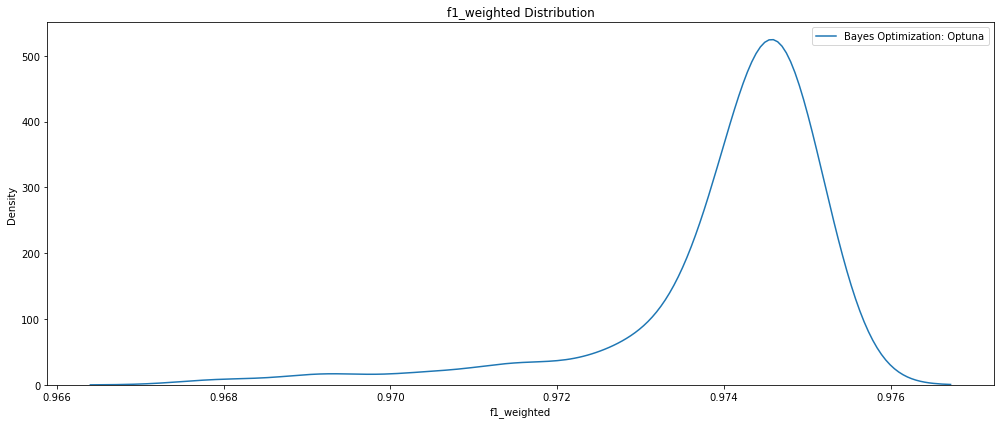

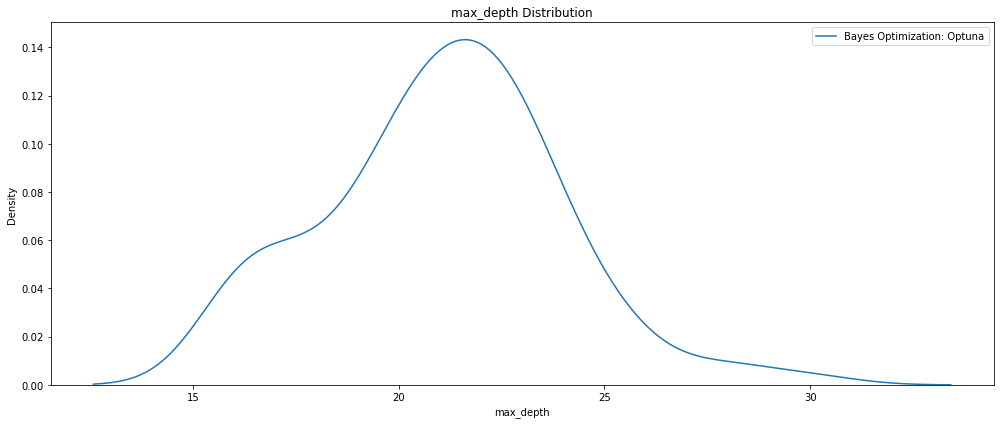

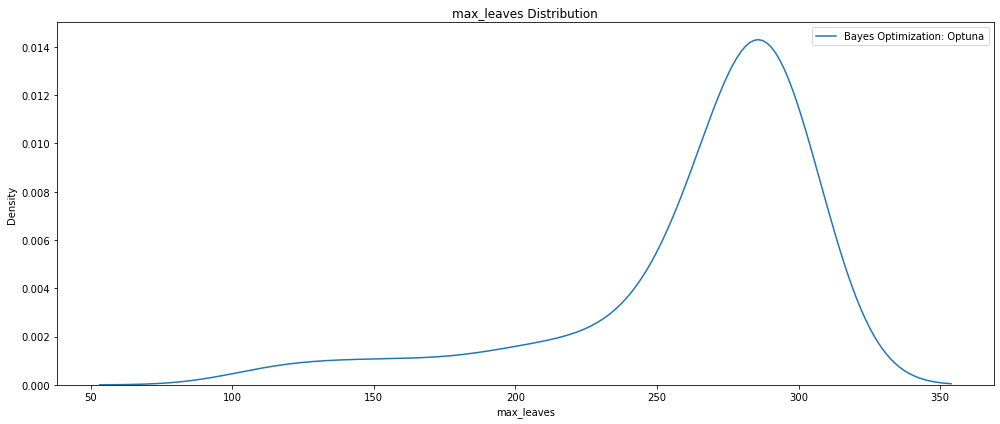

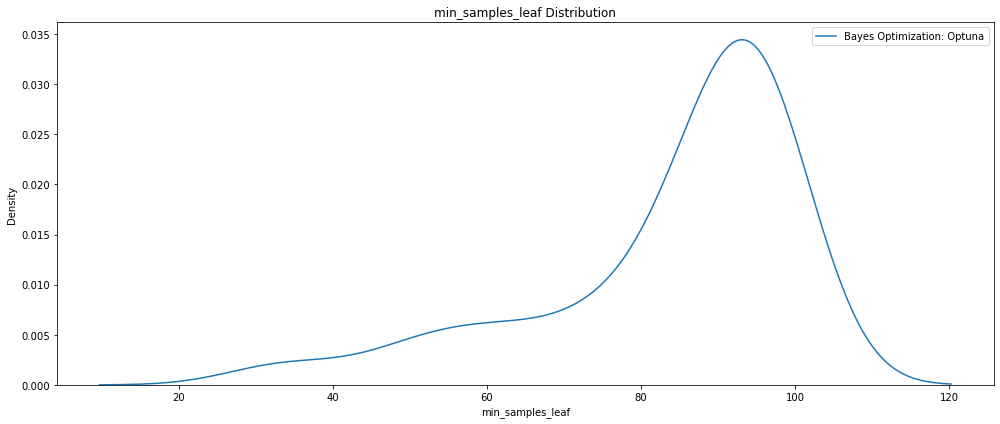

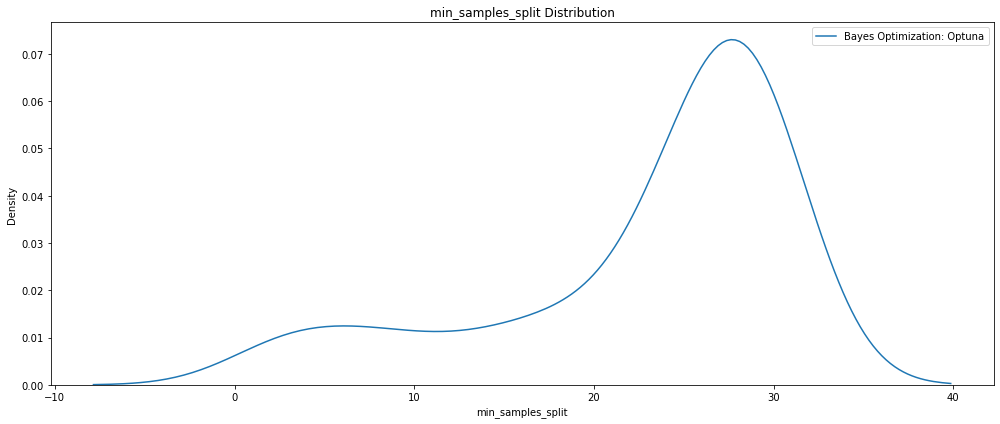

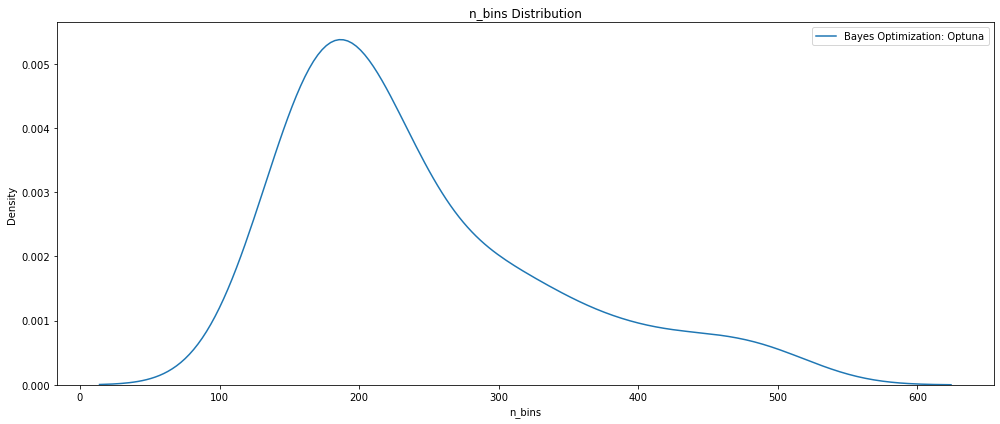

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna'ortance')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

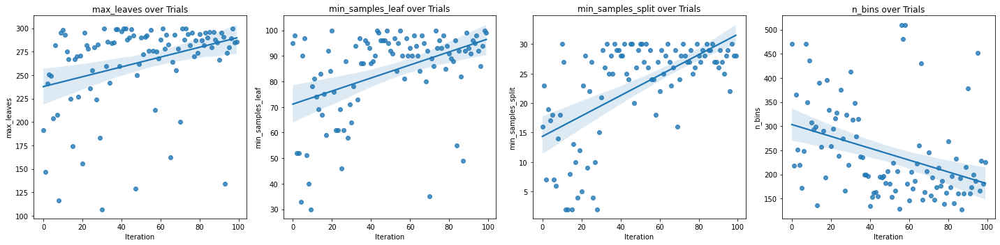

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl')

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 293,
 'max_depth': 24,
 'max_leaves': 285,
 'min_samples_leaf': 100,
 'min_samples_split': 28,
 'n_bins': 181}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_100trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_100trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for RF RAPIDS HPO SMOTE 100 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for RF RAPIDS HPO SMOTE 100 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.72      0.83     54625

    accuracy                           0.96    432473
   macro avg       0.97      0.86      0.90    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[377357    491]
 [ 15542  39083]]


Accuracy score : 0.963
Precision score : 0.988
Recall score : 0.715
F1 score : 0.830


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.85709 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    98
f1_weighted                            0.975129
datetime_start       2022-09-21 12:50:23.145202
datetime_complete    2022-09-21 12:51:13.936928
duration                 0 days 00:00:50.791726
max_depth                                    24
max_leaves                                  285
min_samples_leaf                            100
min_samples_split                            28
n_bins                                      181
n_estimators                                293
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

In [ ]:
# Model metrics with ELI5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1098 ± 0.0002,recoveries
0.0487 ± 0.0004,out_prncp
0.0091 ± 0.0002,total_pymnt
0.0073 ± 0.0001,last_pymnt_amnt
0.0051 ± 0.0002,term_ 60 months
0.0012 ± 0.0001,total_rec_late_fee
0.0008 ± 0.0001,loan_amnt
0.0005 ± 0.0000,installment
0.0004 ± 0.0000,total_rec_int
0.0002 ± 0.0001,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,recoveries,0.109790,0.000109
1,out_prncp,0.048729,0.000188
2,total_pymnt,0.009135,0.000117
3,last_pymnt_amnt,0.007267,0.000044
4,term_ 60 months,0.005130,0.000085
5,total_rec_late_fee,0.001248,0.000033
6,loan_amnt,0.000777,0.000034
7,installment,0.000545,0.000016
8,total_rec_int,0.000430,0.000024
9,inq_last_6mths,0.000196,0.000030


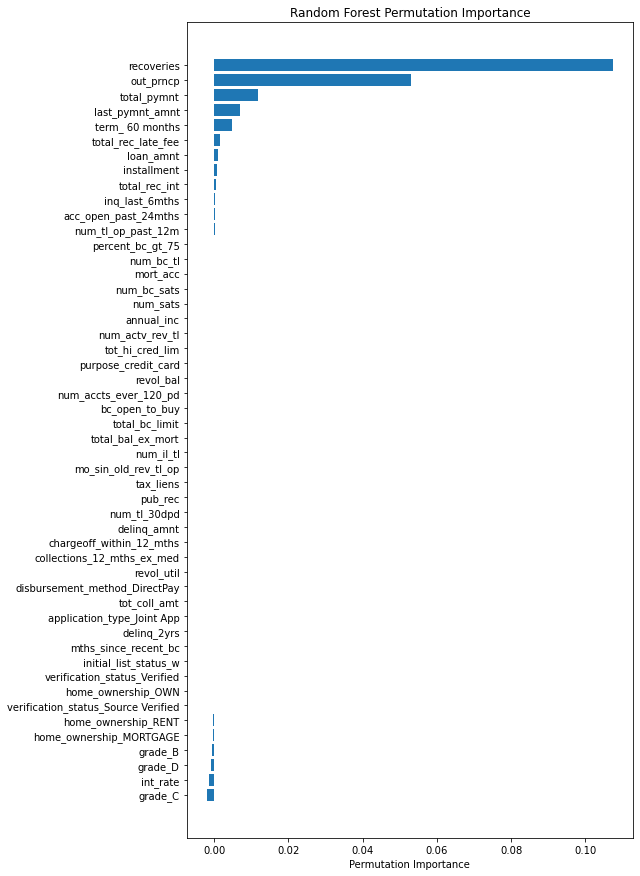

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_smote_rfRapids_weightedF1_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf300gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'smote_rf300gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 200, 700),
        'max_depth': trial.suggest_int('max_depth', 15, 40), 
        'max_leaves': trial.suggest_int('max_leaves', 270, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 75, 130),
        'min_samples_split': trial.suggest_int('min_samples_split', 20, 50),
        'n_bins': trial.suggest_int('n_bins', 160, 300),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')

    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

- Trial time: 38.35554059385322
- Trial weighted F1: 0.9755330231575761
######################################################
- Trial time: 35.37029279884882
- Trial weighted F1: 0.9758345068004183
######################################################
- Trial time: 46.712269293144345
- Trial weighted F1: 0.974191089460713
######################################################
- Trial time: 57.57649332983419
- Trial weighted F1: 0.9748537849269102
######################################################
- Trial time: 50.81937882211059
- Trial weighted F1: 0.9756823631415358
######################################################
- Trial time: 59.24401282588951
- Trial weighted F1: 0.9761893667764617
######################################################
- Trial time: 86.17711771884933
- Trial weighted F1: 0.9759739624468236
######################################################
- Trial time: 82.40384313208051
- Trial weighted F1: 0.9757950279440807
#######################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)

Number of finished trials: 295
Best trial: {'n_estimators': 285, 'max_depth': 18, 'max_leaves': 397, 'min_samples_leaf': 110, 'min_samples_split': 34, 'n_bins': 276}
Highest F1 Score 0.9768440858556522


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=5)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

- Trial time: 69.65158867719583
- Trial weighted F1: 0.9754715666583049
######################################################
- Trial time: 69.36808798694983
- Trial weighted F1: 0.9760616832780624
######################################################
- Trial time: 73.98729942599311
- Trial weighted F1: 0.9765420200284686
######################################################
- Trial time: 73.44472733302973
- Trial weighted F1: 0.9764442545285457
######################################################
- Trial time: 71.60011896188371
- Trial weighted F1: 0.9765122597941738
######################################################
..dask_optuna             :  366.0472
Time to run HPO: 366.0476574897766


Number of finished trials: 300
Best trial: {'n_estimators': 285, 'max_depth': 18, 'max_leaves': 397, 'min_samples_leaf': 110, 'min_samples_split': 34, 'n_bins': 276}
Highest F1 Score 0.9768440858556522


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.csv', index=False)
print(trials_df) 

     iteration  f1_weighted             datetime_start  \
273        273     0.976844 2022-09-23 05:01:28.668997   
293        293     0.976801 2022-09-23 05:22:46.628761   
292        292     0.976759 2022-09-23 05:21:37.924315   
281        281     0.976713 2022-09-23 05:08:01.788012   
289        289     0.976710 2022-09-23 05:18:15.648441   
..         ...          ...                        ...   
35          35     0.974569 2022-09-23 00:43:26.064836   
94          94     0.974281 2022-09-23 01:49:54.256128   
2            2     0.974191 2022-09-23 00:02:42.122028   
58          58     0.974014 2022-09-23 01:05:54.978306   
294        294          NaN 2022-09-23 05:23:57.669881   

             datetime_complete               duration  max_depth  max_leaves  \
273 2022-09-23 05:02:11.666539 0 days 00:00:42.997542       18.0       397.0   
293 2022-09-23 05:23:57.669555 0 days 00:01:11.040794       18.0       400.0   
292 2022-09-23 05:22:46.628438 0 days 00:01:08.704123       18.

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

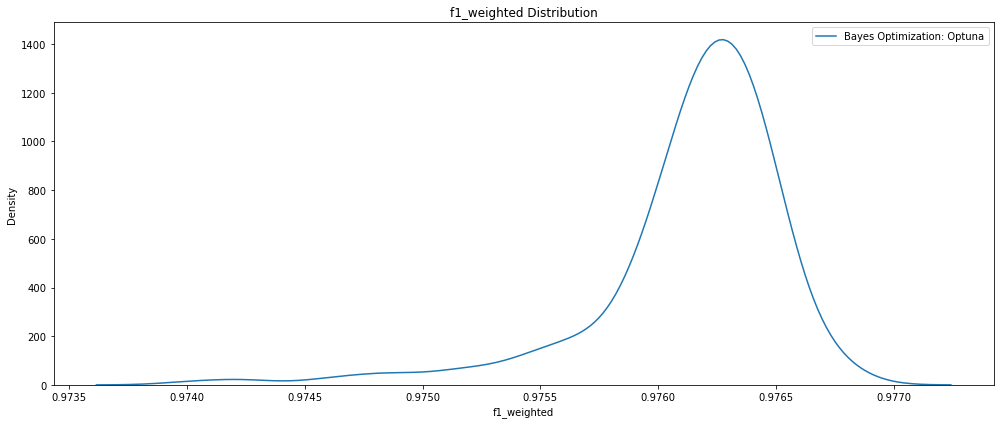

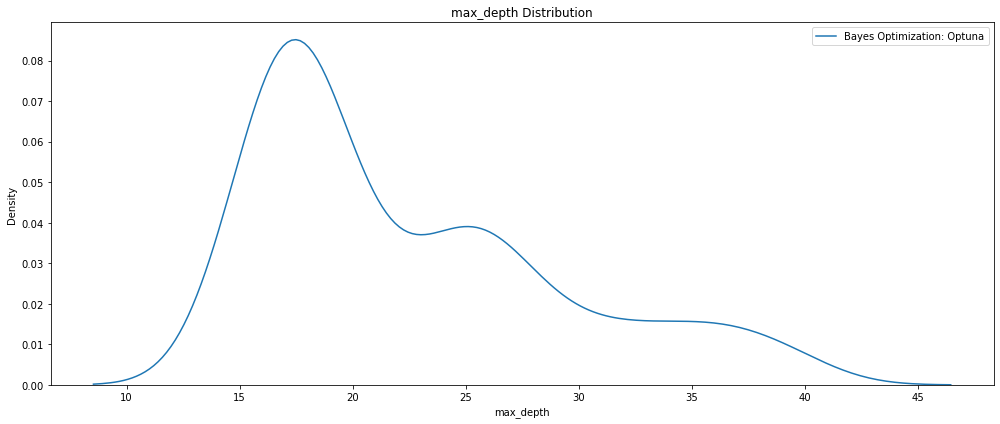

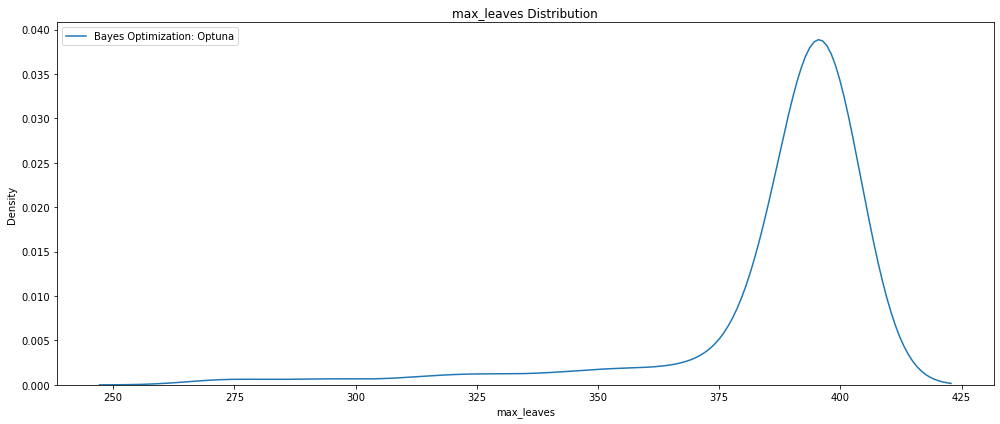

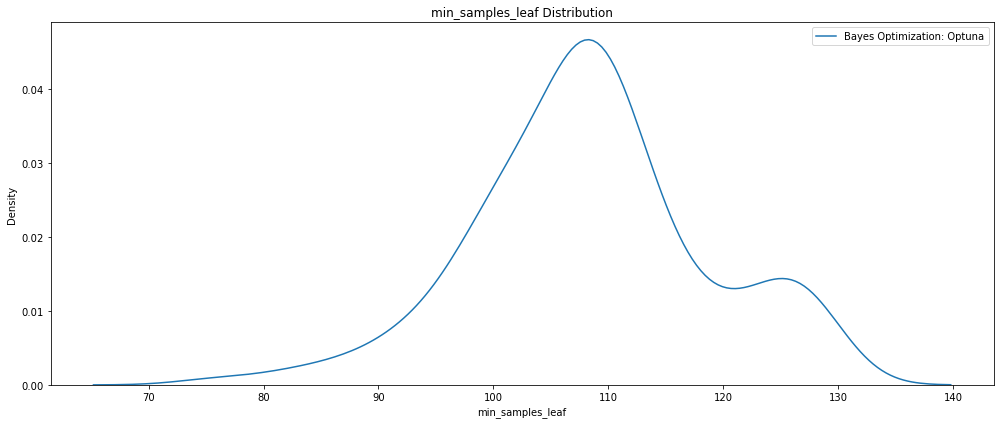

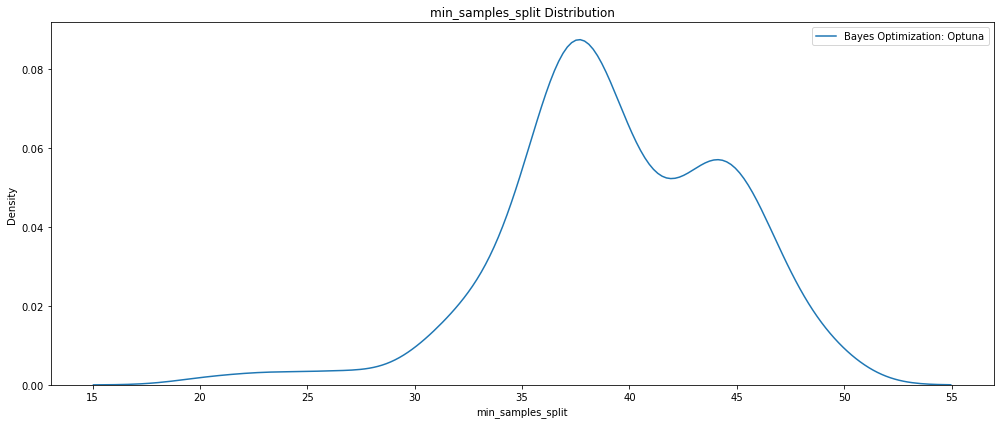

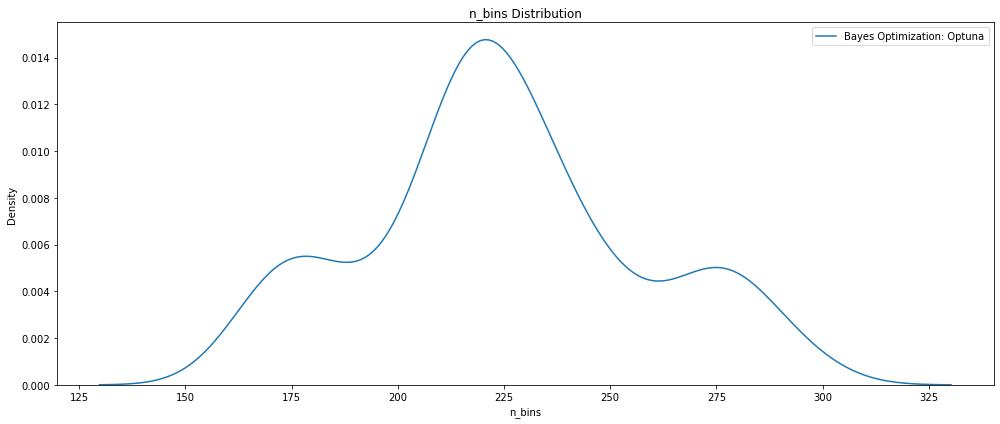

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna'ortance')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

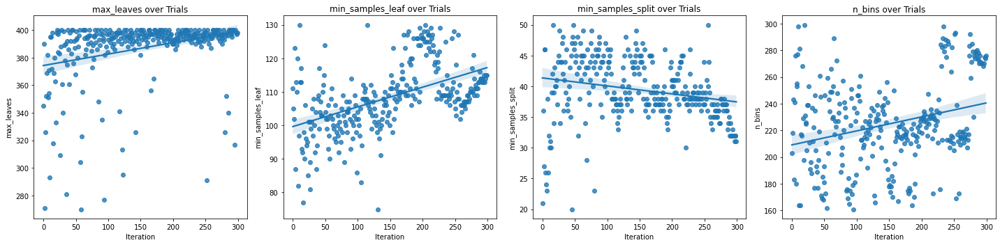

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 285,
 'max_depth': 18,
 'max_leaves': 397,
 'min_samples_leaf': 110,
 'min_samples_split': 34,
 'n_bins': 276,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_300trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_300trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for RF RAPIDS HPO SMOTE 300 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for RF RAPIDS HPO SMOTE 300 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.74      0.85     54625

    accuracy                           0.97    432473
   macro avg       0.98      0.87      0.91    432473
weighted avg       0.97      0.97      0.96    432473



Confusion matrix:
[[377445    403]
 [ 14178  40447]]


Accuracy score : 0.966
Precision score : 0.990
Recall score : 0.740
F1 score : 0.847


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.86969 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   273
f1_weighted                            0.976844
datetime_start       2022-09-23 05:01:28.668997
datetime_complete    2022-09-23 05:02:11.666539
duration                 0 days 00:00:42.997542
max_depth                                  18.0
max_leaves                                397.0
min_samples_leaf                          110.0
min_samples_split                          34.0
n_bins                                    276.0
n_estimators                              285.0
state                                  COMPLETE
Name: 273, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

In [ ]:
# Model metrics with ELI5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1050 ± 0.0002,recoveries
0.0661 ± 0.0003,out_prncp
0.0150 ± 0.0002,total_pymnt
0.0081 ± 0.0002,last_pymnt_amnt
0.0039 ± 0.0001,term_ 60 months
0.0014 ± 0.0001,total_rec_late_fee
0.0011 ± 0.0001,loan_amnt
0.0010 ± 0.0001,installment
0.0006 ± 0.0001,total_rec_int
0.0003 ± 0.0000,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,recoveries,0.105046,0.000111
1,out_prncp,0.066119,0.000156
2,total_pymnt,0.015024,0.000115
3,last_pymnt_amnt,0.008143,0.000090
4,term_ 60 months,0.003919,0.000035
5,total_rec_late_fee,0.001401,0.000045
6,loan_amnt,0.001056,0.000070
7,installment,0.001040,0.000044
8,total_rec_int,0.000616,0.000041
9,inq_last_6mths,0.000340,0.000017


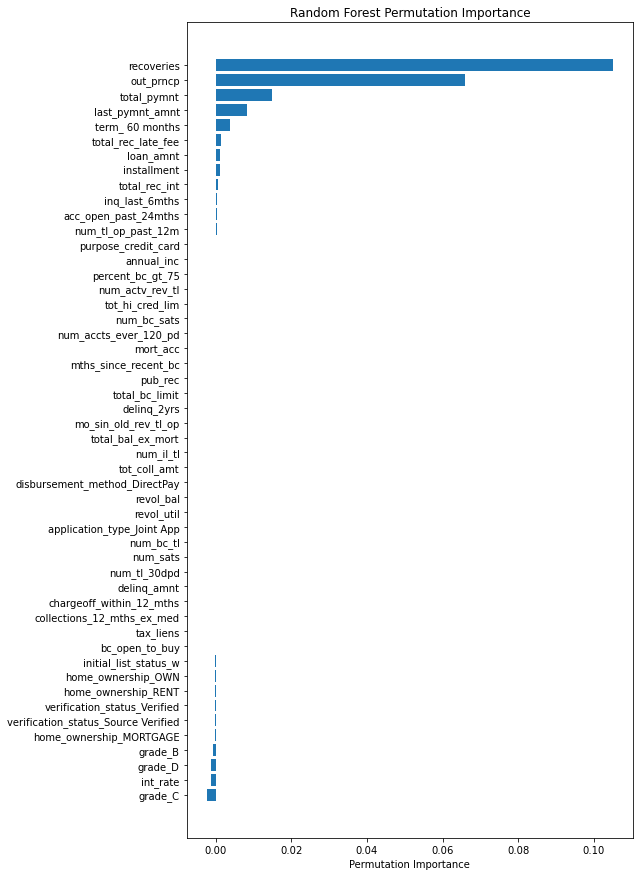

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Weighted ROC

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_wROC_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf00gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'rf100gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = roc_auc_score(asnumpy(y_val), asnumpy(y_pred_val)), 
                          average='weighted')  
     
    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

- Trial time: 19.85409746482037
- Trial weighted ROC: 0.9731171546275762
######################################################
- Trial time: 25.9486181109678
- Trial weighted ROC: 0.9722583997161808
######################################################
- Trial time: 14.36065408680588
- Trial weighted ROC: 0.9691030620413073
######################################################
- Trial time: 62.47623286116868
- Trial weighted ROC: 0.9694174541009588
######################################################
- Trial time: 16.1498267990537
- Trial weighted ROC: 0.9745219185974812
######################################################
- Trial time: 55.289428912103176
- Trial weighted ROC: 0.9727878982907969
######################################################
- Trial time: 49.995923498179764
- Trial weighted ROC: 0.9744259698478753
######################################################
- Trial time: 69.74363829893991
- Trial weighted ROC: 0.974694017967534
################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.csv', index=False)
print(trials_df) 

    iteration  roc_weighted             datetime_start  \
92         92      0.975546 2022-09-21 23:35:58.516198   
53         53      0.975228 2022-09-21 22:55:09.748154   
51         51      0.975200 2022-09-21 22:52:46.648062   
94         94      0.975121 2022-09-21 23:38:15.516243   
42         42      0.975114 2022-09-21 22:43:20.719643   
..        ...           ...                        ...   
57         57      0.970991 2022-09-21 22:58:37.146579   
26         26      0.970898 2022-09-21 22:28:22.639946   
3           3      0.969417 2022-09-21 22:06:38.063350   
2           2      0.969103 2022-09-21 22:06:23.288599   
35         35      0.968397 2022-09-21 22:36:43.650001   

            datetime_complete               duration  max_depth  max_leaves  \
92 2022-09-21 23:37:06.794990 0 days 00:01:08.278792         23         300   
53 2022-09-21 22:56:13.684576 0 days 00:01:03.936422         23         300   
51 2022-09-21 22:53:57.969344 0 days 00:01:11.321282         21   

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

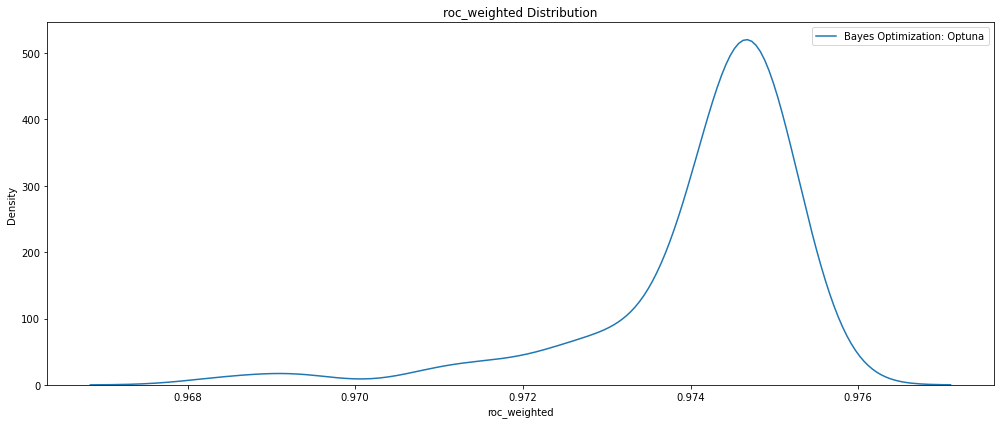

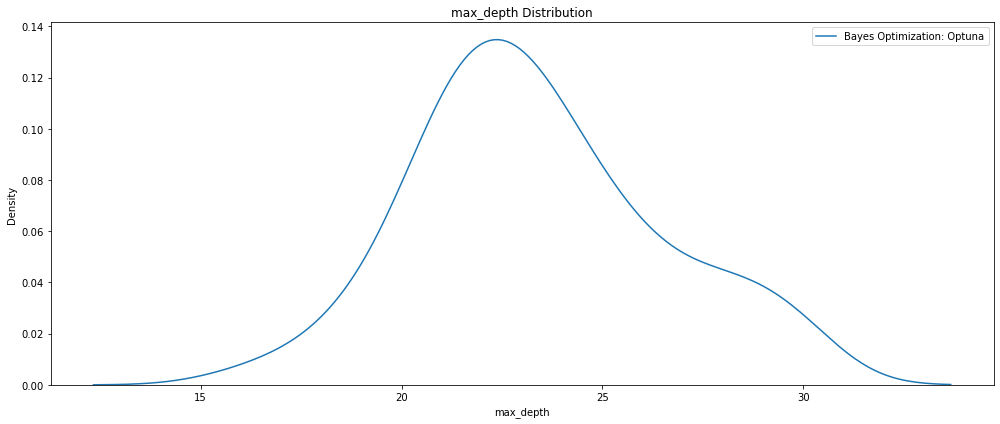

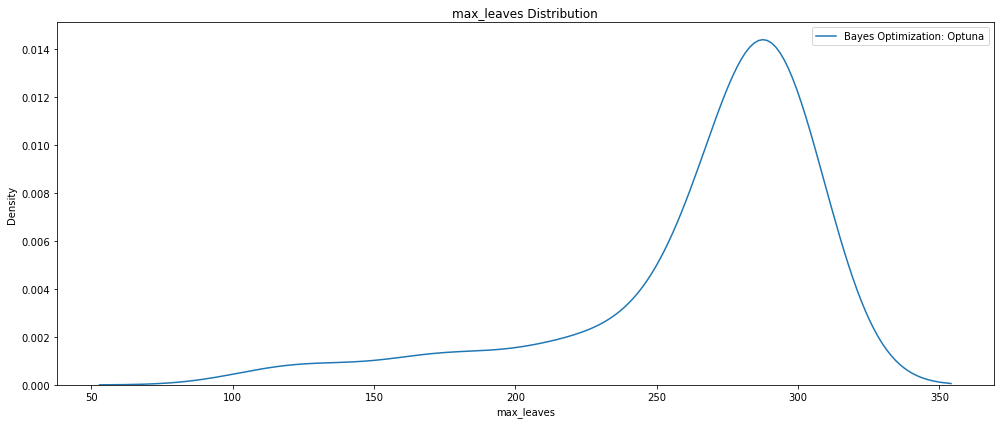

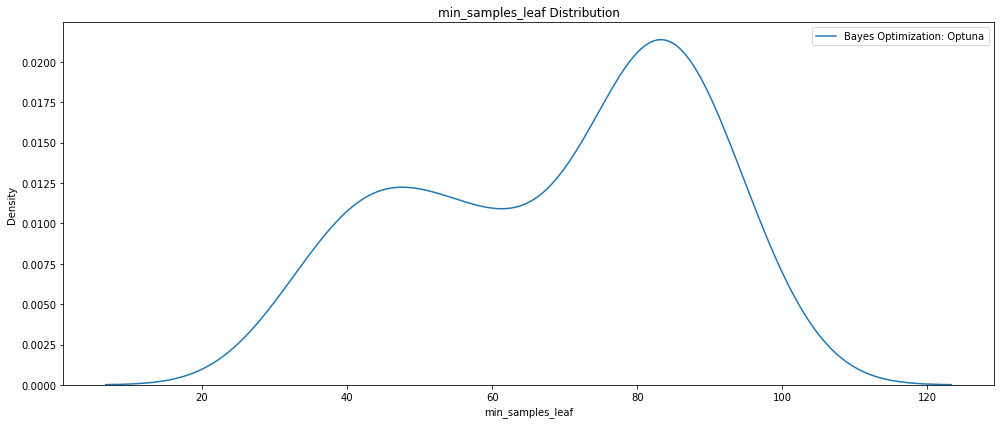

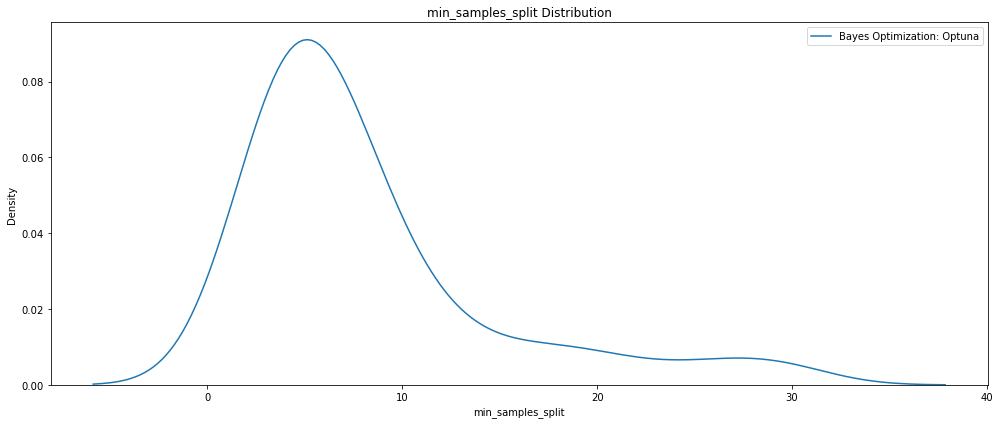

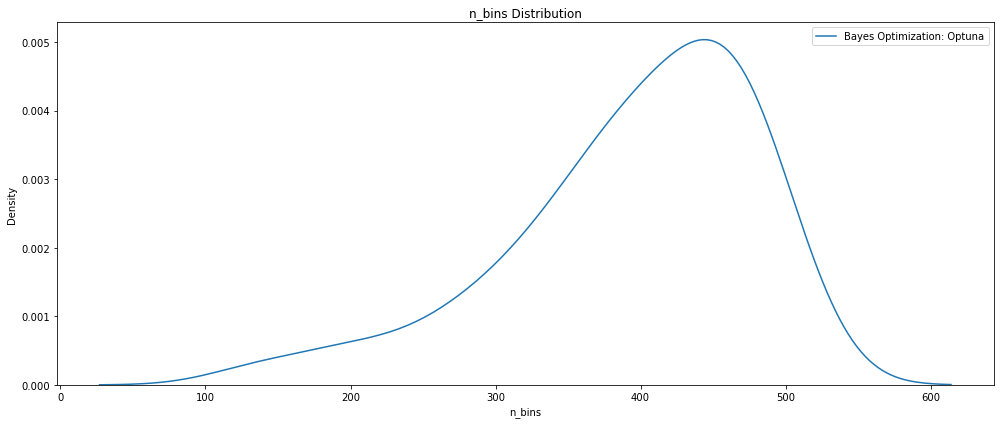

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

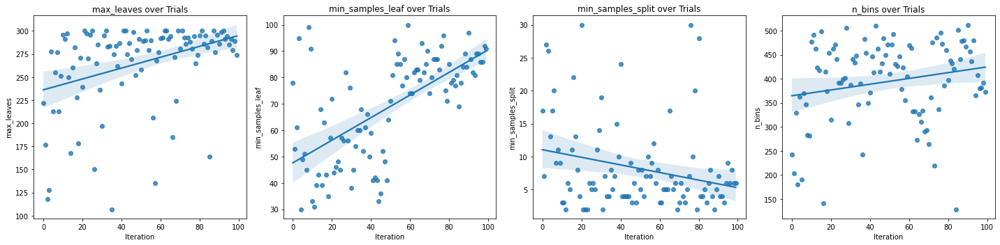

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 460, 'max_depth': 23, 'max_leaves': 300, 'min_samples_leaf': 82, 'min_samples_split': 4, 'n_bins': 437}
Highest ROCweighted score 0.9755461396356307
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 460,
 'max_depth': 23,
 'max_leaves': 300,
 'min_samples_leaf': 82,
 'min_samples_split': 4,
 'n_bins': 437,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_trials100_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTESMOTE_trials100_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.73      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.98      0.86      0.91    432473
weighted avg       0.97      0.96      0.96    432473



Confusion matrix:
[[377388    460]
 [ 14911  39714]]


Accuracy score : 0.964
Precision score : 0.989
Recall score : 0.727
F1 score : 0.838


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.86291 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    92
roc_weighted                           0.975546
datetime_start       2022-09-21 23:35:58.516198
datetime_complete    2022-09-21 23:37:06.794990
duration                 0 days 00:01:08.278792
max_depth                                    23
max_leaves                                  300
min_samples_leaf                             82
min_samples_split                             4
n_bins                                      437
n_estimators                                460
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1076 ± 0.0002,recoveries
0.0553 ± 0.0003,out_prncp
0.0123 ± 0.0001,total_pymnt
0.0068 ± 0.0001,last_pymnt_amnt
0.0037 ± 0.0001,term_ 60 months
0.0014 ± 0.0001,total_rec_late_fee
0.0010 ± 0.0001,loan_amnt
0.0008 ± 0.0001,installment
0.0004 ± 0.0000,total_rec_int
0.0002 ± 0.0000,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,recoveries,0.107618,0.000121
1,out_prncp,0.055273,0.000135
2,total_pymnt,0.012327,0.000068
3,last_pymnt_amnt,0.006771,0.000056
4,term_ 60 months,0.003724,0.000044
5,total_rec_late_fee,0.001447,0.000040
6,loan_amnt,0.001003,0.000062
7,installment,0.000757,0.000048
8,total_rec_int,0.000445,0.000015
9,inq_last_6mths,0.000246,0.000022


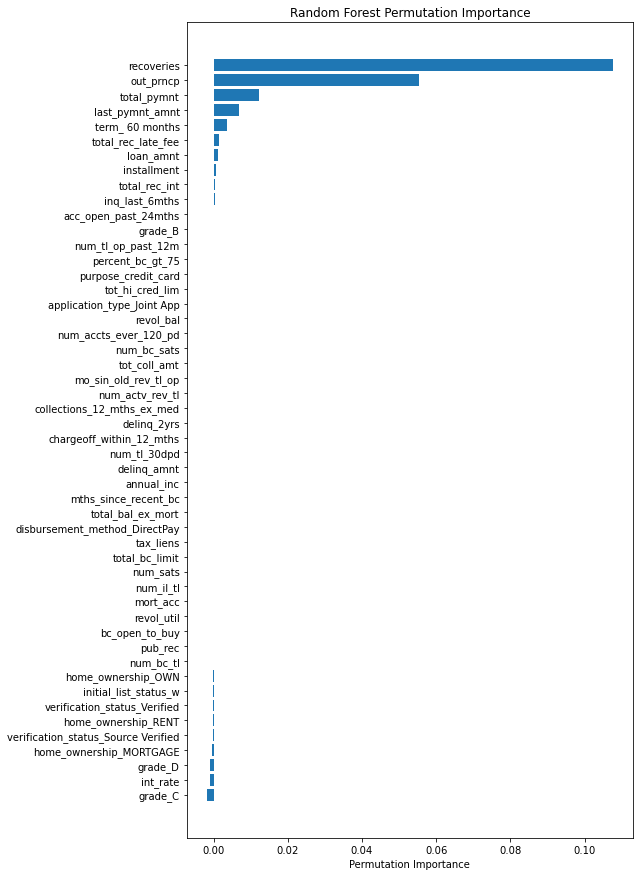

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_permImportance.png', 
          dpi=my_dpi, bbox_inches='tight')

### 300 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_wROC_300_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf300gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'smote_rf300gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 20, 40), 
        'max_leaves': trial.suggest_int('max_leaves', 270, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 40, 110),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 12),
        'n_bins': trial.suggest_int('n_bins', 330, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = roc_auc_score(y_val.to_numpy(), y_pred_val.to_numpy(), 
                          average='weighted')
     
    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

- Trial time: 100.406936773099
- Trial weighted ROC: 0.9746993851267108
######################################################
- Trial time: 124.38496277411468
- Trial weighted ROC: 0.9739040295393027
######################################################
- Trial time: 118.19132284005173
- Trial weighted ROC: 0.9743845247476056
######################################################
- Trial time: 78.36416005692445
- Trial weighted ROC: 0.9753818263397235
######################################################
- Trial time: 115.78727076901123
- Trial weighted ROC: 0.9755026045589084
######################################################
- Trial time: 107.07019687700085
- Trial weighted ROC: 0.9751582925549459
######################################################
- Trial time: 112.69405902293511
- Trial weighted ROC: 0.9748713816076958
######################################################
- Trial time: 87.32568157301284
- Trial weighted ROC: 0.9752562418354186
###########################

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

Number of finished trials: 90
Best trial: {'n_estimators': 513, 'max_depth': 39, 'max_leaves': 395, 'min_samples_leaf': 61, 'min_samples_split': 7, 'n_bins': 498}
Highest ROCweighted score 0.9761108100465946


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=210)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 80.13616381492466
- Trial weighted ROC: 0.9762035686835772
######################################################
- Trial time: 76.17264597117901
- Trial weighted ROC: 0.9761109191479157
######################################################
- Trial time: 78.47481847647578
- Trial weighted ROC: 0.9759884864833407
######################################################
- Trial time: 78.5514516364783
- Trial weighted ROC: 0.976087756320568
######################################################
- Trial time: 80.68443219084293
- Trial weighted ROC: 0.9757138425581408
######################################################
- Trial time: 75.50953079294413
- Trial weighted ROC: 0.9761340815811014
######################################################
- Trial time: 76.9286245116964
- Trial weighted ROC: 0.9757287328169358
######################################################
- Trial time: 78.76209788303822
- Trial weighted ROC: 0.9759719433663157
##################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.csv', index=False)
print(trials_df) 

     iteration  roc_weighted             datetime_start  \
279        279      0.976880 2022-09-28 04:52:32.918098   
280        280      0.976877 2022-09-28 04:53:47.632861   
261        261      0.976862 2022-09-28 04:30:03.894098   
253        253      0.976857 2022-09-28 04:19:54.995877   
266        266      0.976852 2022-09-28 04:36:23.142874   
..         ...           ...                        ...   
2            2      0.974385 2022-09-23 22:39:56.638363   
69          69      0.974193 2022-09-24 00:30:50.918645   
1            1      0.973904 2022-09-23 22:37:51.880457   
28          28      0.973651 2022-09-23 23:29:18.267174   
89          89           NaN 2022-09-24 00:59:15.597832   

             datetime_complete               duration  max_depth  max_leaves  \
279 2022-09-28 04:53:47.632530 0 days 00:01:14.714432       25.0       392.0   
280 2022-09-28 04:55:02.363544 0 days 00:01:14.730683       25.0       396.0   
261 2022-09-28 04:31:20.422525 0 days 00:01:16.5284

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

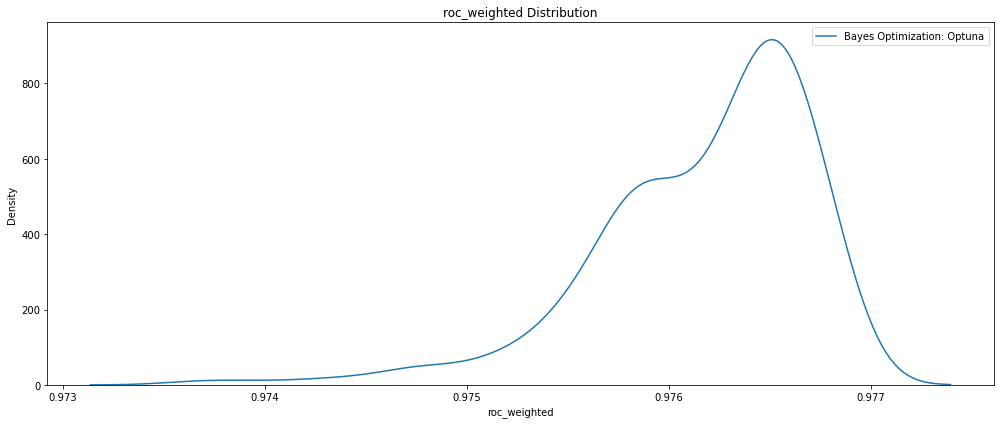

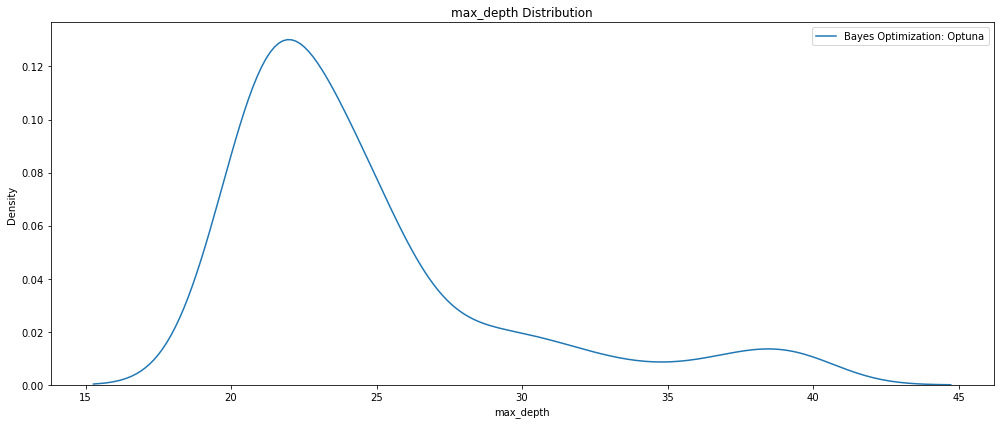

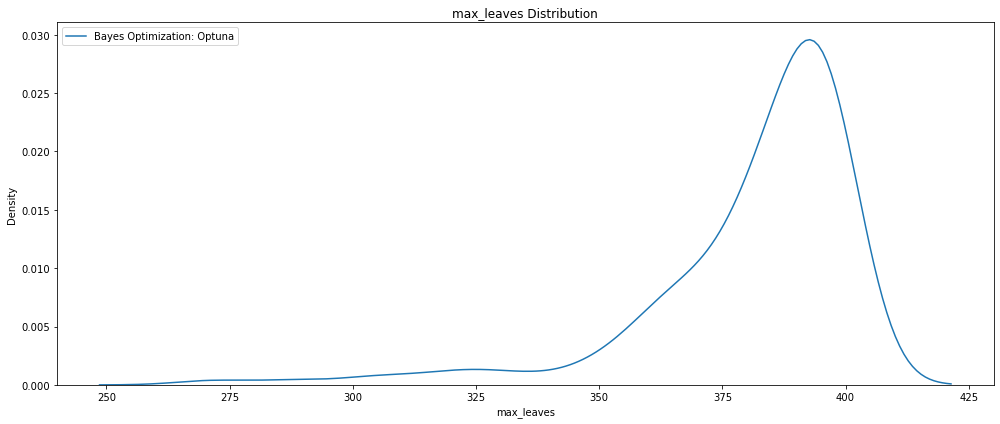

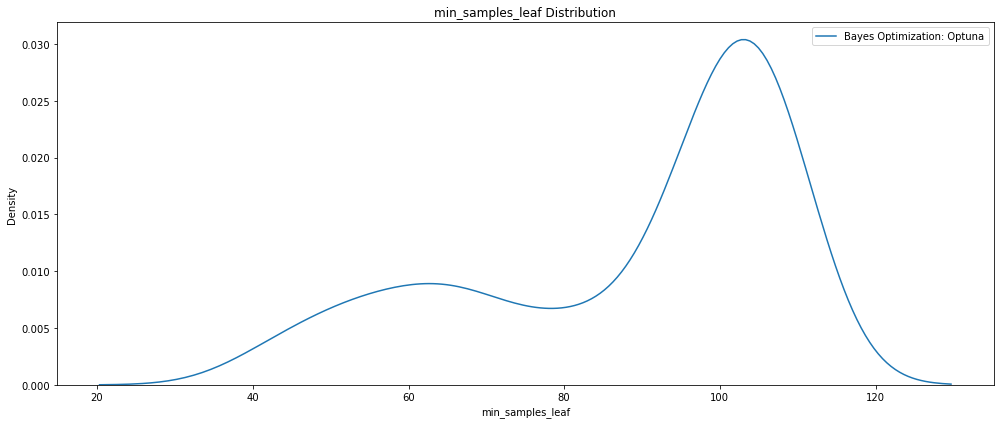

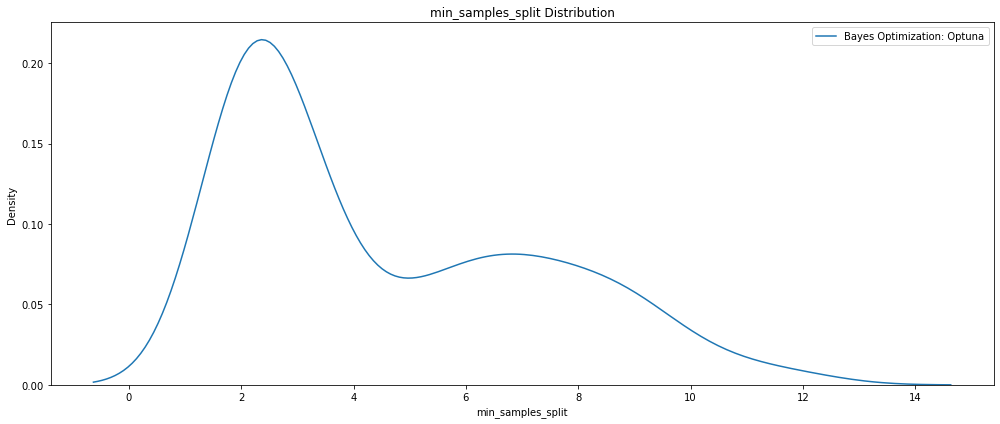

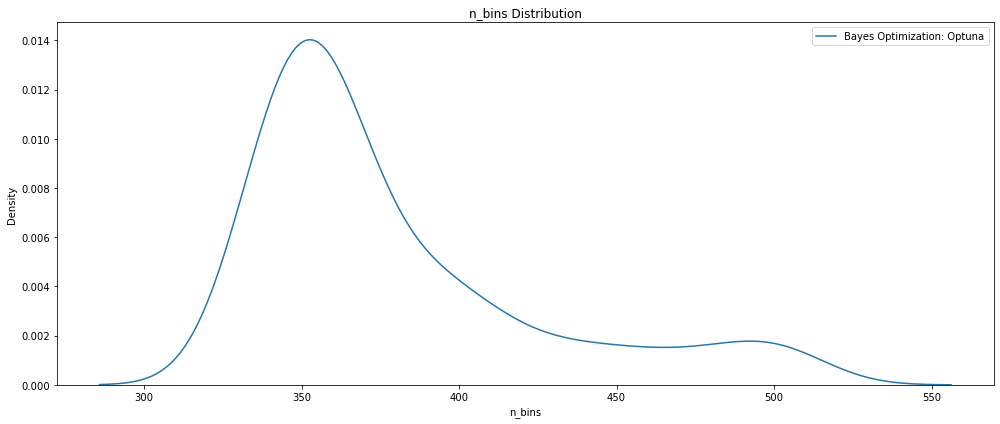

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

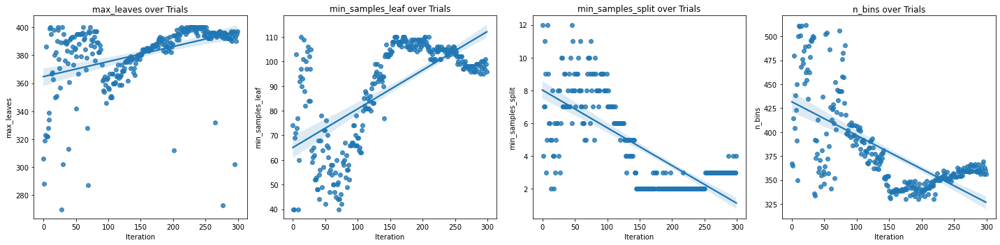

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 494,
 'max_depth': 25,
 'max_leaves': 392,
 'min_samples_leaf': 97,
 'min_samples_split': 3,
 'n_bins': 365,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_trials300_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTESMOTE_trials300_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.73      0.84     54625

    accuracy                           0.97    432473
   macro avg       0.98      0.86      0.91    432473
weighted avg       0.97      0.97      0.96    432473



Confusion matrix:
[[377470    378]
 [ 14711  39914]]


Accuracy score : 0.965
Precision score : 0.991
Recall score : 0.731
F1 score : 0.841


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.86485 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   279
roc_weighted                            0.97688
datetime_start       2022-09-28 04:52:32.918098
datetime_complete    2022-09-28 04:53:47.632530
duration                 0 days 00:01:14.714432
max_depth                                  25.0
max_leaves                                392.0
min_samples_leaf                           97.0
min_samples_split                           3.0
n_bins                                    365.0
n_estimators                              494.0
state                                  COMPLETE
Name: 279, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1074 ± 0.0002,recoveries
0.0613 ± 0.0002,out_prncp
0.0128 ± 0.0002,total_pymnt
0.0067 ± 0.0001,last_pymnt_amnt
0.0037 ± 0.0001,term_ 60 months
0.0013 ± 0.0001,total_rec_late_fee
0.0010 ± 0.0001,loan_amnt
0.0008 ± 0.0000,installment
0.0006 ± 0.0000,total_rec_int
0.0002 ± 0.0001,num_tl_op_past_12m


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,recoveries,0.107371,0.000104
1,out_prncp,0.061297,0.000122
2,total_pymnt,0.012761,0.000078
3,last_pymnt_amnt,0.006743,0.000066
4,term_ 60 months,0.003720,0.000030
5,total_rec_late_fee,0.001310,0.000062
6,loan_amnt,0.001006,0.000060
7,installment,0.000817,0.000014
8,total_rec_int,0.000581,0.000013
9,num_tl_op_past_12m,0.000228,0.000056


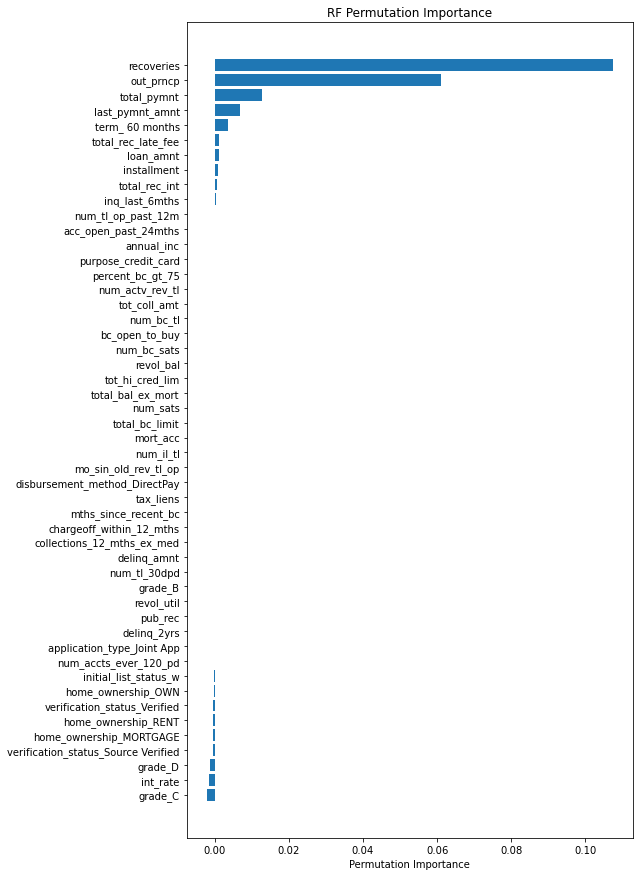

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('RF Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Recall

### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_recall_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf100gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'SMOTE_rf100gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
      
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

- Trial time: 72.00938271614723
- Trial recall: 0.9505867022965393
######################################################
- Trial time: 29.79835127084516
- Trial recall: 0.9493663350619113
######################################################
- Trial time: 54.95877530192956
- Trial recall: 0.9502559794687269
######################################################
- Trial time: 59.229643038939685
- Trial recall: 0.9502659011535612
######################################################
- Trial time: 26.627737663919106
- Trial recall: 0.9491877447348925
######################################################
- Trial time: 36.35665032500401
- Trial recall: 0.950206371044555
######################################################
- Trial time: 40.33559781895019
- Trial recall: 0.9498524976187956
######################################################
- Trial time: 47.431826905114576
- Trial recall: 0.9507586781670018
######################################################
- Trial time: 33.30880

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_recall.csv', index=False)
print(trials_df) 

     iteration    recall             datetime_start  \
36          36  0.952070 2022-09-21 20:44:04.222713   
52          52  0.951825 2022-09-21 20:53:50.409389   
22          22  0.951689 2022-09-21 20:33:01.496755   
95          95  0.951550 2022-09-21 21:26:11.652912   
44          44  0.951543 2022-09-21 20:47:50.459506   
..         ...       ...                        ...   
8            8  0.939722 2022-09-21 20:21:46.830869   
1            1  0.939642 2022-09-21 20:17:57.522809   
181        181  0.938267 2022-10-04 01:47:58.731096   
99          99       NaN 2022-09-21 21:27:40.310931   
100        100       NaN 2022-09-21 21:47:15.240329   

             datetime_complete               duration  max_depth  max_leaves  \
36  2022-09-21 20:44:34.253518 0 days 00:00:30.030805       19.0       292.0   
52  2022-09-21 20:54:38.710064 0 days 00:00:48.300675       29.0       299.0   
22  2022-09-21 20:33:43.950407 0 days 00:00:42.453652       26.0       298.0   
95  2022-09-21 21:2

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

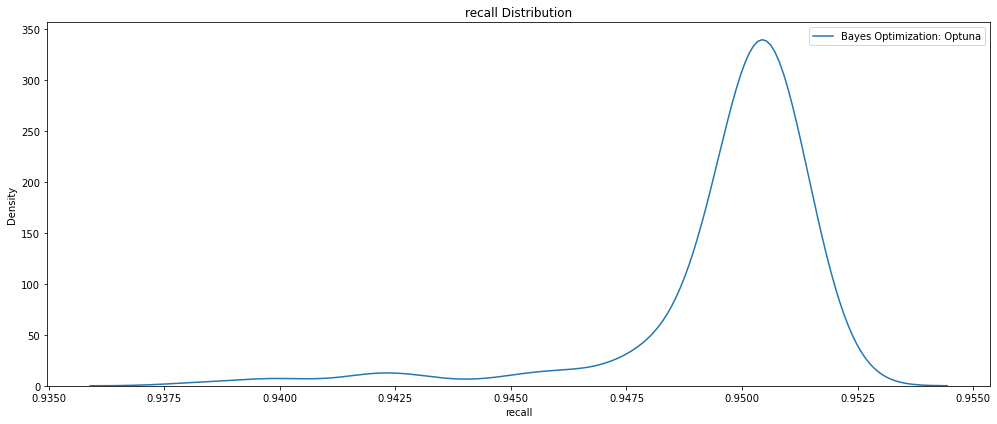

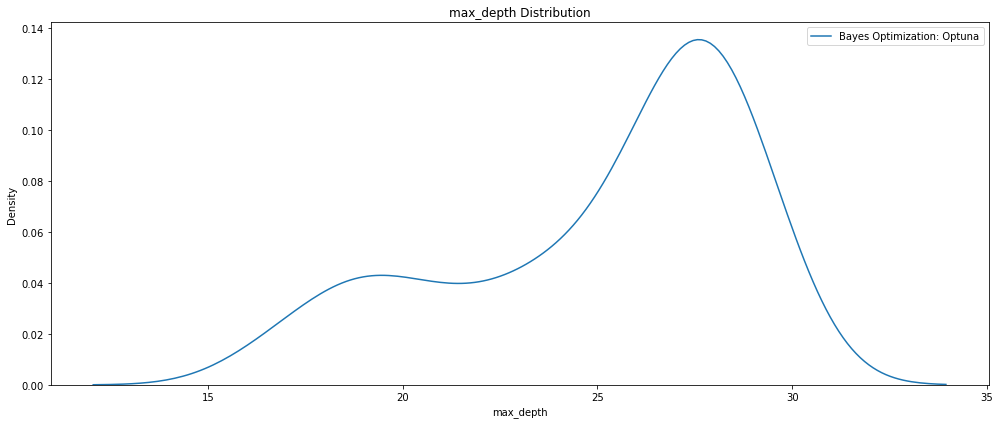

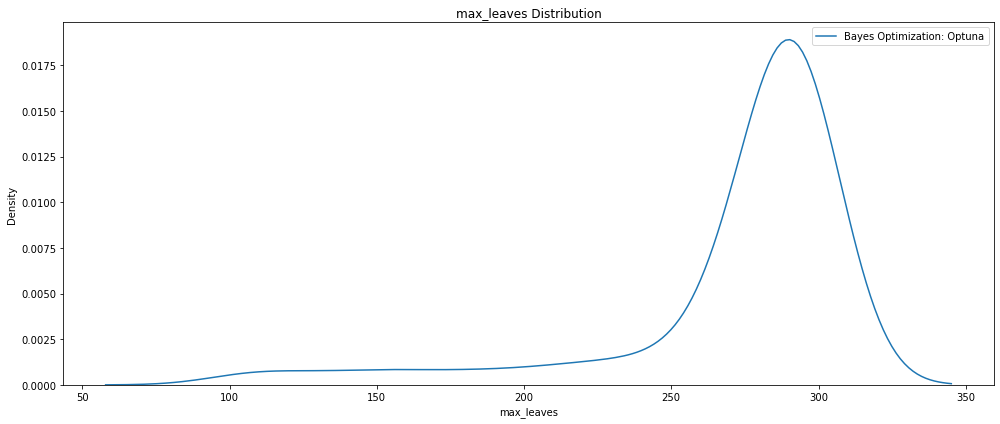

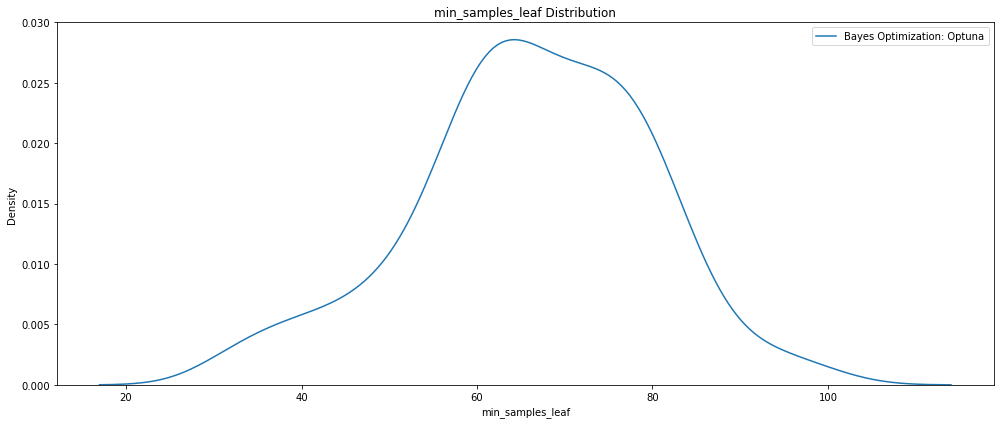

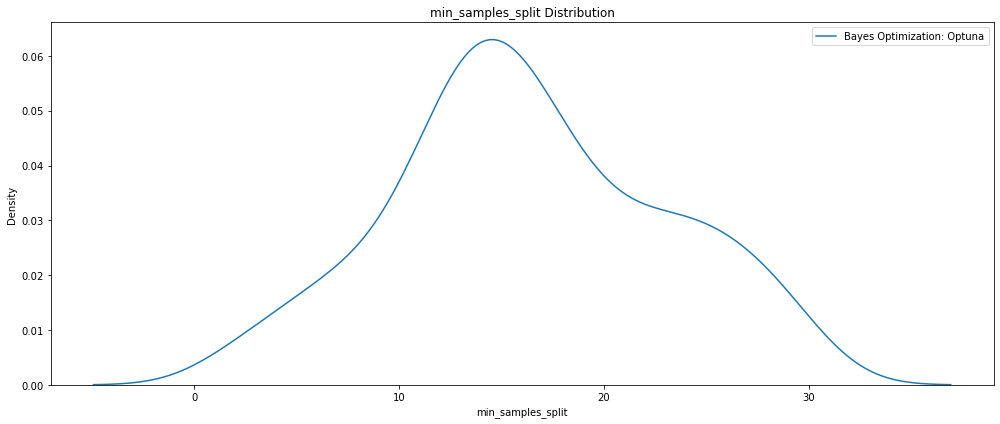

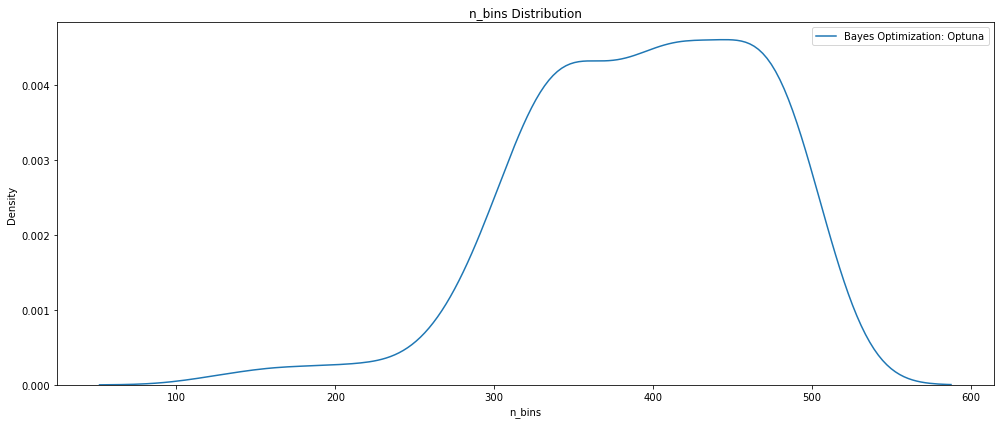

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

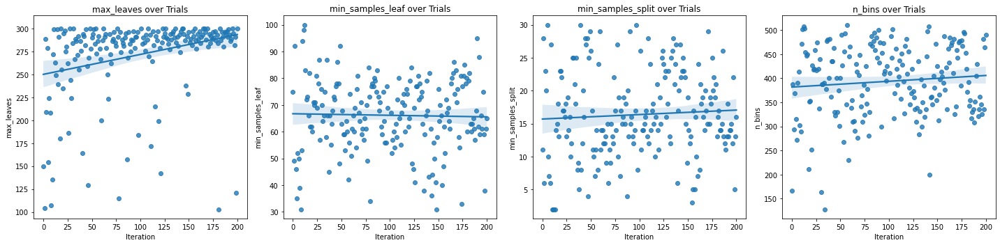

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value  
params

{'n_estimators': 200,
 'max_depth': 19,
 'max_leaves': 292,
 'min_samples_leaf': 66,
 'min_samples_split': 8,
 'n_bins': 477,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_100trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_100trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.72      0.83     54625

    accuracy                           0.96    432473
   macro avg       0.98      0.86      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[377467    381]
 [ 15487  39138]]


Accuracy score : 0.963
Precision score : 0.990
Recall score : 0.716
F1 score : 0.831


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.85774 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    36
recall                                  0.95207
datetime_start       2022-09-21 20:44:04.222713
datetime_complete    2022-09-21 20:44:34.253518
duration                 0 days 00:00:30.030805
max_depth                                  19.0
max_leaves                                292.0
min_samples_leaf                           66.0
min_samples_split                           8.0
n_bins                                    477.0
n_estimators                              200.0
state                                  COMPLETE
Name: 36, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1093 ± 0.0002,recoveries
0.0482 ± 0.0003,out_prncp
0.0104 ± 0.0001,total_pymnt
0.0064 ± 0.0001,last_pymnt_amnt
0.0050 ± 0.0001,term_ 60 months
0.0013 ± 0.0001,total_rec_late_fee
0.0007 ± 0.0001,loan_amnt
0.0006 ± 0.0001,installment
0.0003 ± 0.0000,total_rec_int
0.0002 ± 0.0000,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,recoveries,0.109325,0.000117
1,out_prncp,0.048202,0.000132
2,total_pymnt,0.010440,0.000060
3,last_pymnt_amnt,0.006436,0.000031
4,term_ 60 months,0.005001,0.000046
5,total_rec_late_fee,0.001326,0.000027
6,loan_amnt,0.000691,0.000035
7,installment,0.000636,0.000031
8,total_rec_int,0.000283,0.000023
9,inq_last_6mths,0.000243,0.000024


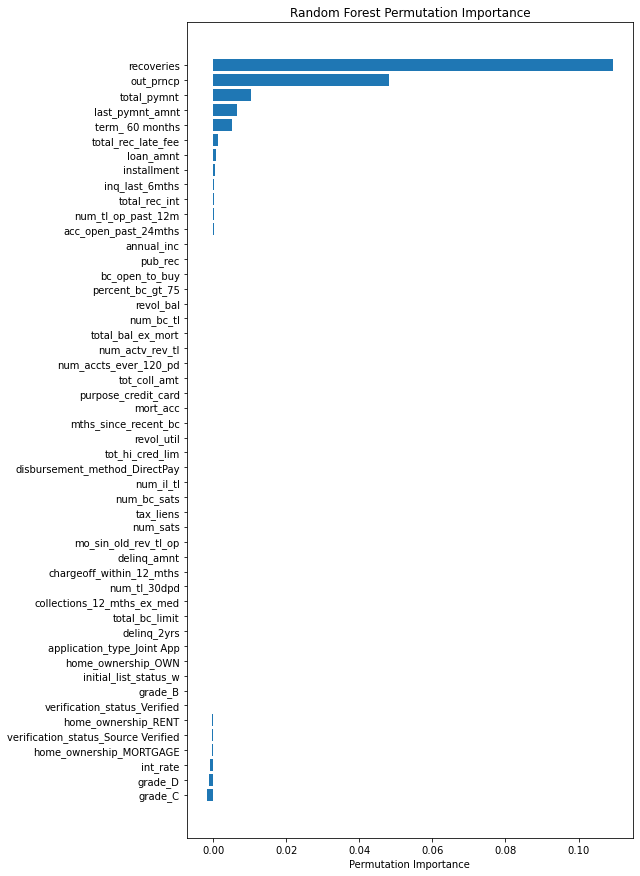

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_100_GPU_recall_permImportance.png', 
          dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_recall_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf300gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'SMOTE_rf300gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 160, 600),
        'max_depth': trial.suggest_int('max_depth', 18, 35), 
        'max_leaves': trial.suggest_int('max_leaves', 265, 350), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 50, 120),
        'min_samples_split': trial.suggest_int('min_samples_split', 4, 35),
        'n_bins': trial.suggest_int('n_bins', 300, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)

Number of finished trials: 43
Best trial: {'n_estimators': 421, 'max_depth': 26, 'max_leaves': 347, 'min_samples_leaf': 74, 'min_samples_split': 7, 'n_bins': 494}
Highest Recall Score 0.9527680118759257


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=257)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 58.08516751998104
- Trial recall: 0.9515859655634055
######################################################
- Trial time: 37.453079434810206
- Trial recall: 0.951251275797622
######################################################
- Trial time: 42.571177452104166
- Trial recall: 0.9524641119785798
######################################################
- Trial time: 30.300813511013985
- Trial recall: 0.9511319804355606
######################################################
- Trial time: 48.388783659087494
- Trial recall: 0.9510524501941864
######################################################
- Trial time: 52.21175374998711
- Trial recall: 0.951605848123749
######################################################
- Trial time: 24.355198782868683
- Trial recall: 0.9492398234428642
######################################################
- Trial time: 38.37227653688751
- Trial recall: 0.9513805124398552
######################################################
- Trial time: 69.8420

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_recall.csv', index=False)
print(trials_df) 

     iteration    recall             datetime_start  \
216        216  0.953018 2022-09-23 21:30:40.043148   
250        250  0.952802 2022-09-23 21:56:36.357780   
247        247  0.952782 2022-09-23 21:54:30.210264   
18          18  0.952768 2022-09-23 18:30:10.299673   
244        244  0.952696 2022-09-23 21:52:15.705625   
..         ...       ...                        ...   
6            6  0.949474 2022-09-23 18:17:43.479158   
49          49  0.949240 2022-09-23 19:13:40.448039   
283        283  0.949154 2022-09-23 22:20:51.012034   
280        280  0.948511 2022-09-23 22:18:15.911206   
42          42       NaN 2022-09-23 18:57:38.583367   

             datetime_complete               duration  max_depth  max_leaves  \
216 2022-09-23 21:31:23.021231 0 days 00:00:42.978083       18.0       341.0   
250 2022-09-23 21:57:18.895947 0 days 00:00:42.538167       19.0       341.0   
247 2022-09-23 21:55:12.665918 0 days 00:00:42.455654       19.0       341.0   
18  2022-09-23 18:3

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

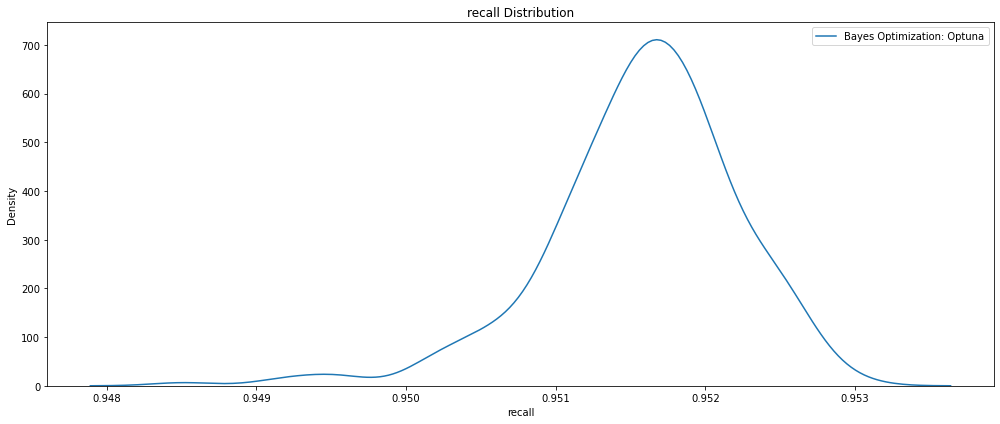

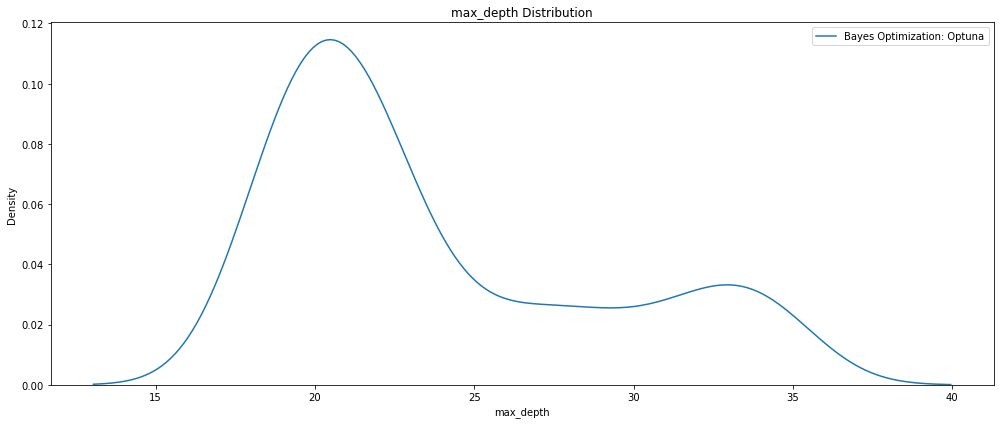

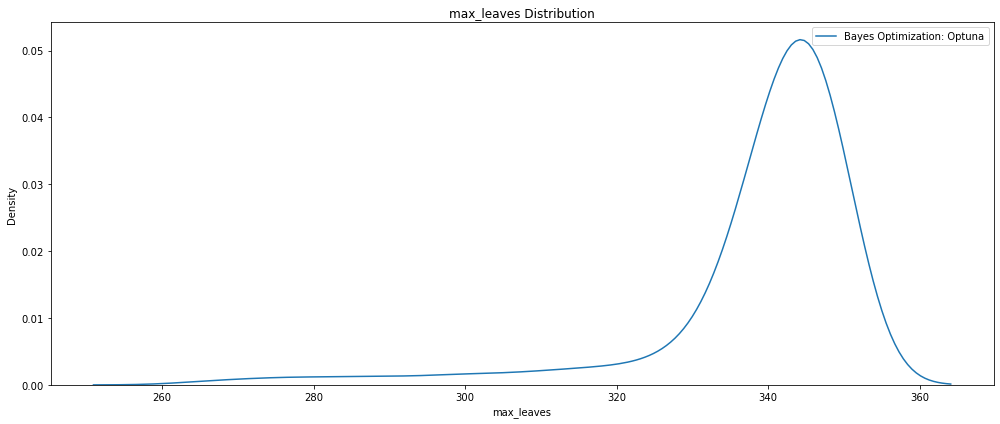

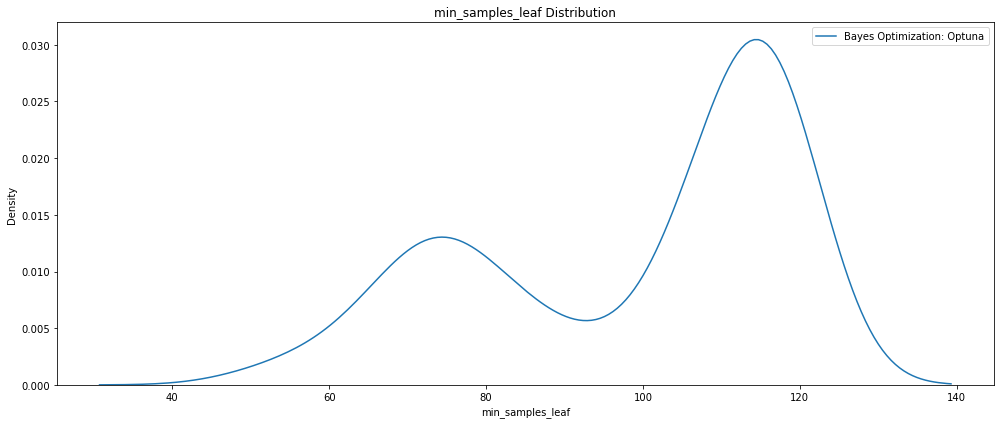

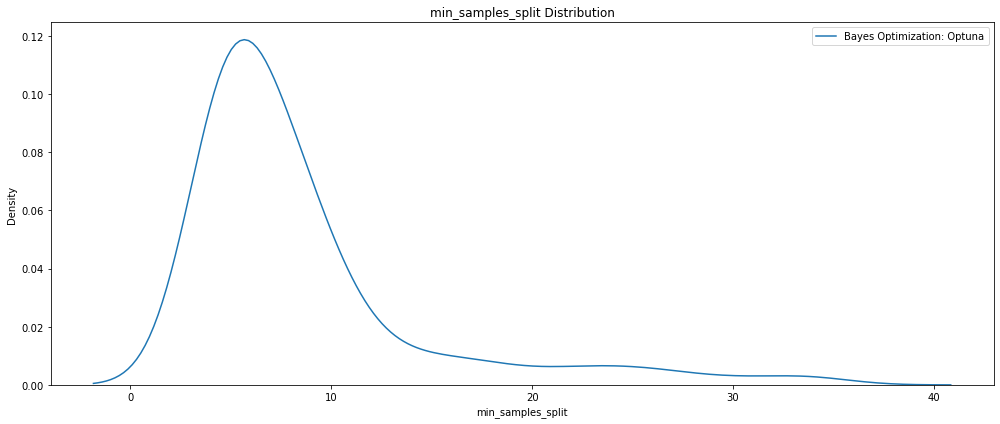

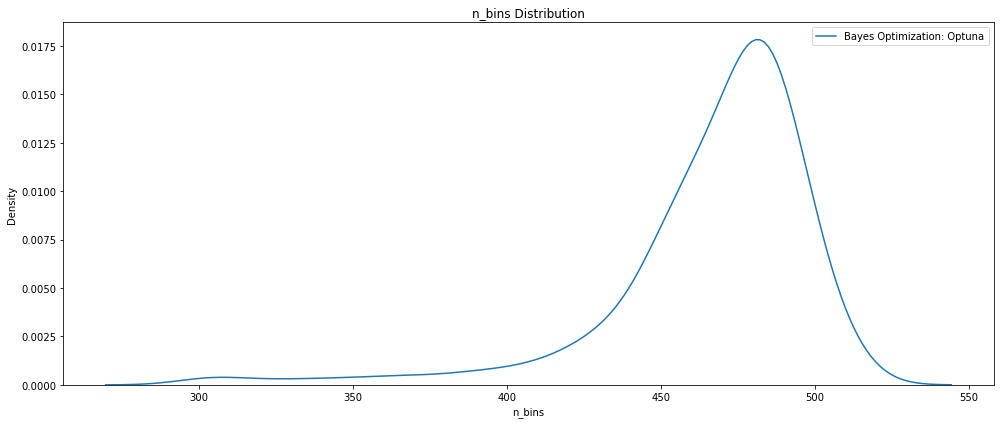

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

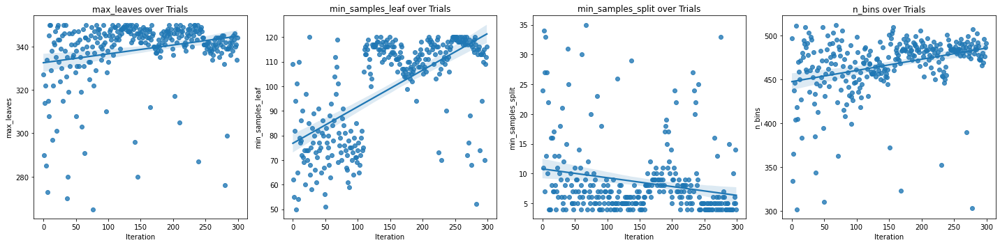

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value  
params

{'n_estimators': 282,
 'max_depth': 18,
 'max_leaves': 341,
 'min_samples_leaf': 116,
 'min_samples_split': 8,
 'n_bins': 484,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_300trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_300trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.73      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.98      0.86      0.91    432473
weighted avg       0.97      0.96      0.96    432473



Confusion matrix:
[[377429    419]
 [ 14804  39821]]


Accuracy score : 0.965
Precision score : 0.990
Recall score : 0.729
F1 score : 0.840


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.86394 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   216
recall                                 0.953018
datetime_start       2022-09-23 21:30:40.043148
datetime_complete    2022-09-23 21:31:23.021231
duration                 0 days 00:00:42.978083
max_depth                                  18.0
max_leaves                                341.0
min_samples_leaf                          116.0
min_samples_split                           8.0
n_bins                                    484.0
n_estimators                              282.0
state                                  COMPLETE
Name: 216, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1074 ± 0.0002,recoveries
0.0610 ± 0.0003,out_prncp
0.0122 ± 0.0002,total_pymnt
0.0071 ± 0.0001,last_pymnt_amnt
0.0044 ± 0.0001,term_ 60 months
0.0014 ± 0.0001,total_rec_late_fee
0.0010 ± 0.0001,loan_amnt
0.0008 ± 0.0001,installment
0.0006 ± 0.0000,total_rec_int
0.0002 ± 0.0000,acc_open_past_24mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,recoveries,0.107425,0.000096
1,out_prncp,0.061018,0.000169
2,total_pymnt,0.012199,0.000087
3,last_pymnt_amnt,0.007063,0.000070
4,term_ 60 months,0.004434,0.000042
5,total_rec_late_fee,0.001428,0.000046
6,loan_amnt,0.000962,0.000035
7,installment,0.000848,0.000041
8,total_rec_int,0.000632,0.000022
9,acc_open_past_24mths,0.000164,0.000022


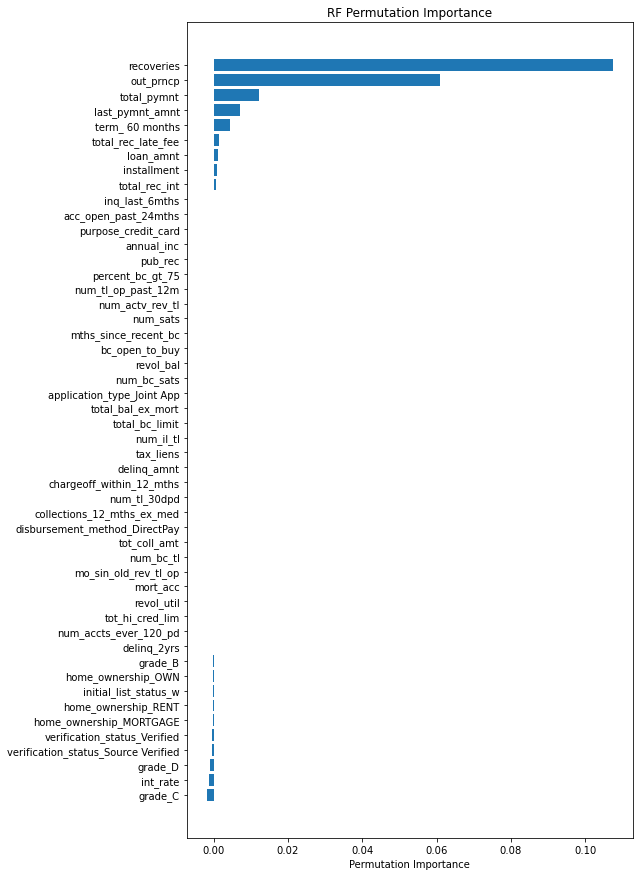

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('RF Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_300_GPU_recall_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Precision

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_precision_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

# called us but it's smote
wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf100gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'smote_rf100gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 19.9379825880751
- Trial precision: 0.9989930489015871
######################################################
- Trial time: 64.00788705213927
- Trial precision: 0.9981630269968803
######################################################
- Trial time: 18.626892044907436
- Trial precision: 0.9979452993014017
######################################################
- Trial time: 44.86317072296515
- Trial precision: 0.9987486313155013
######################################################
- Trial time: 63.7788711078465
- Trial precision: 0.9972819606357757
######################################################
- Trial time: 25.446115436032414
- Trial precision: 0.9982163840859493
######################################################
- Trial time: 41.05821951688267
- Trial precision: 0.9985525249045745
######################################################
- Trial time: 64.0478967439849
- Trial precision: 0.9985939903528249
######################################################
-

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_precision.csv', index=False)
print(trials_df) 

    iteration  precision             datetime_start  \
68         68   0.999187 2022-09-21 19:54:33.858279   
69         69   0.999134 2022-09-21 19:54:53.784247   
73         73   0.999120 2022-09-21 19:56:12.435282   
61         61   0.999111 2022-09-21 19:52:17.839546   
70         70   0.999109 2022-09-21 19:55:13.939577   
..        ...        ...                        ...   
1           1   0.998163 2022-09-21 19:22:09.760325   
97         97   0.998158 2022-09-21 20:04:32.023667   
2           2   0.997945 2022-09-21 19:23:14.577441   
36         36   0.997789 2022-09-21 19:40:34.057177   
4           4   0.997282 2022-09-21 19:24:18.813874   

            datetime_complete               duration  max_depth  max_leaves  \
68 2022-09-21 19:54:53.784053 0 days 00:00:19.925774         17         212   
69 2022-09-21 19:55:13.939378 0 days 00:00:20.155131         18         216   
73 2022-09-21 19:56:30.851004 0 days 00:00:18.415722         17         215   
61 2022-09-21 19:52:38.

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

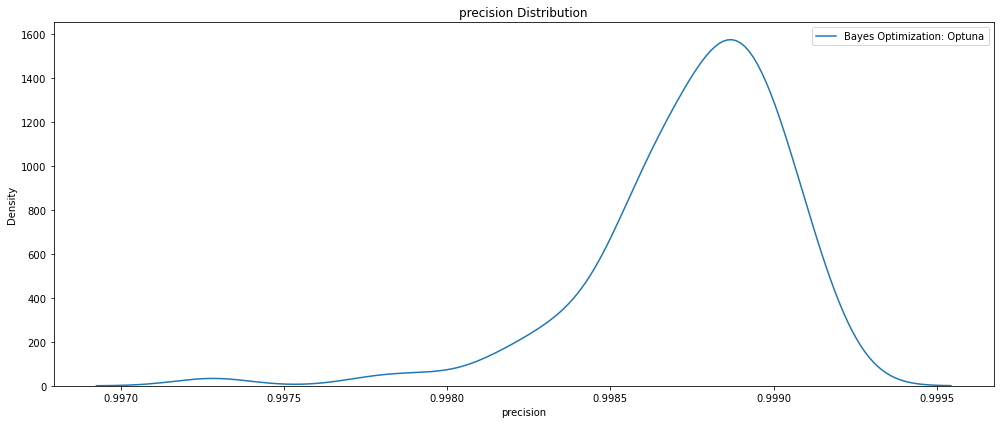

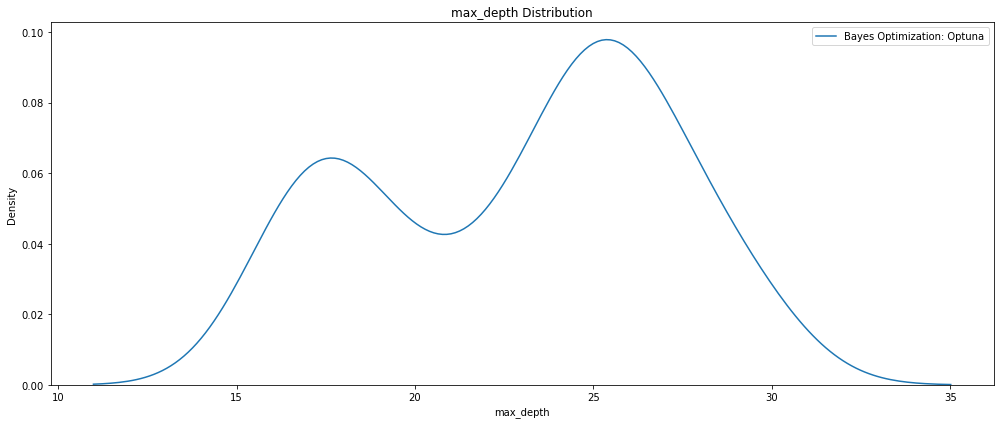

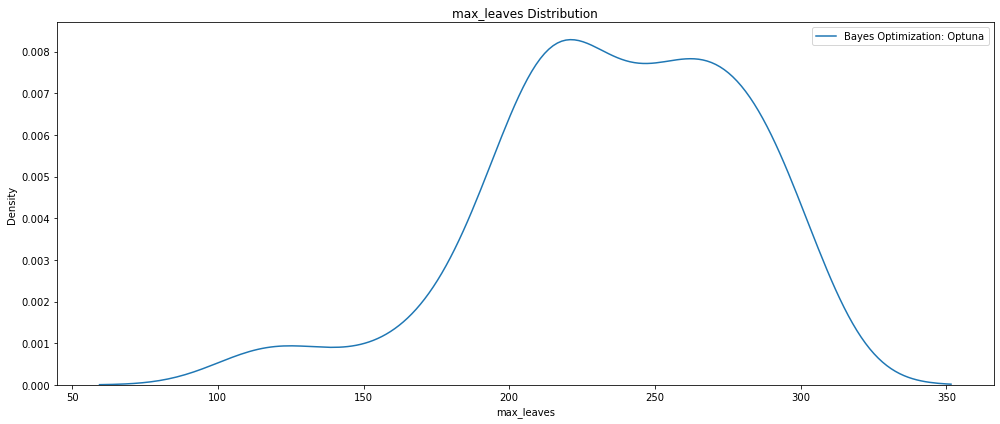

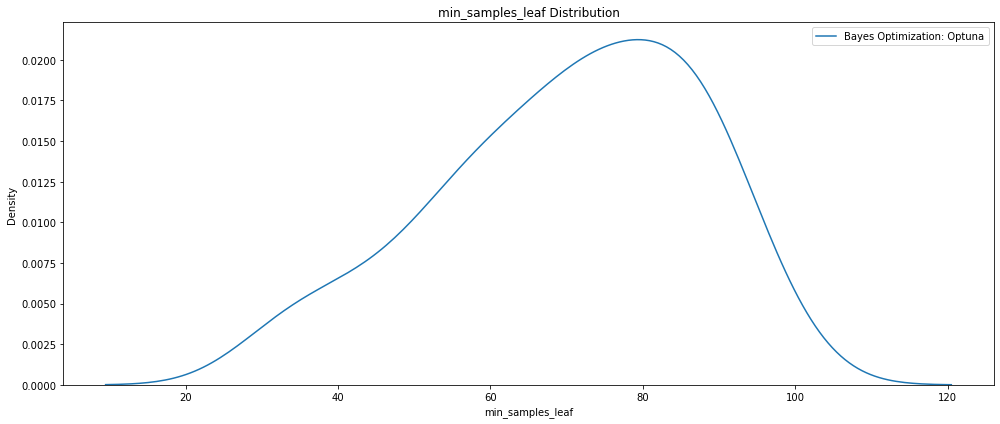

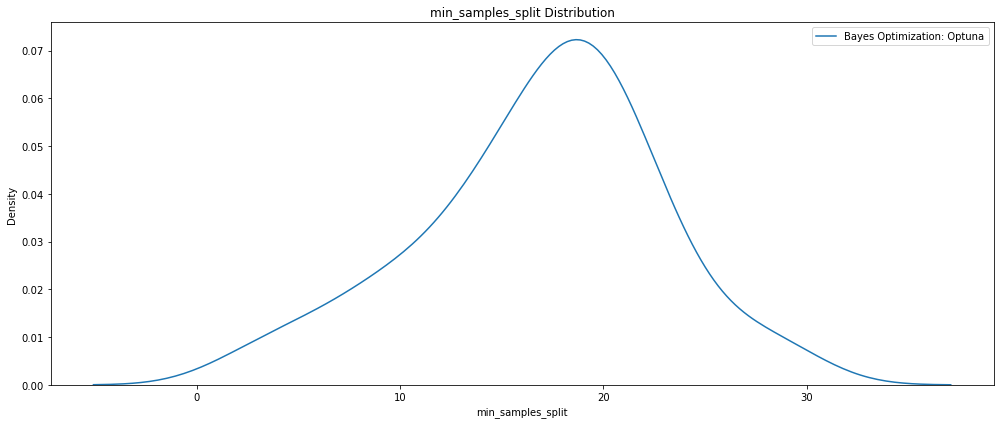

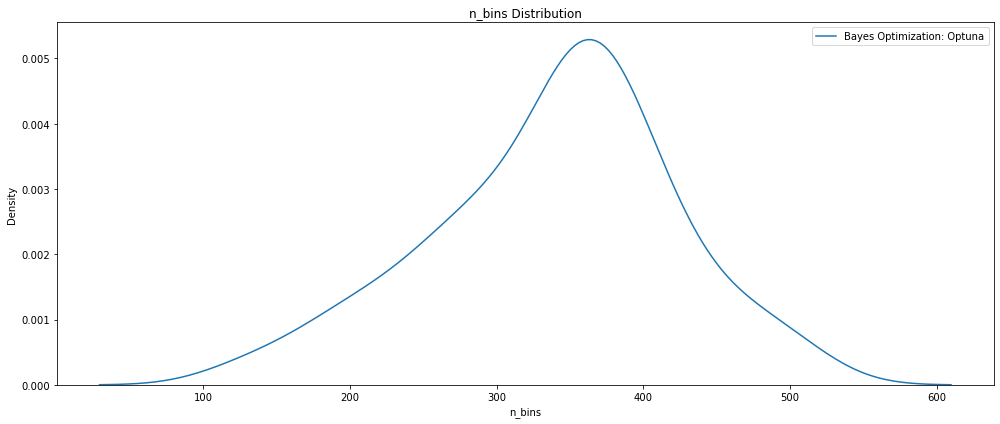

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

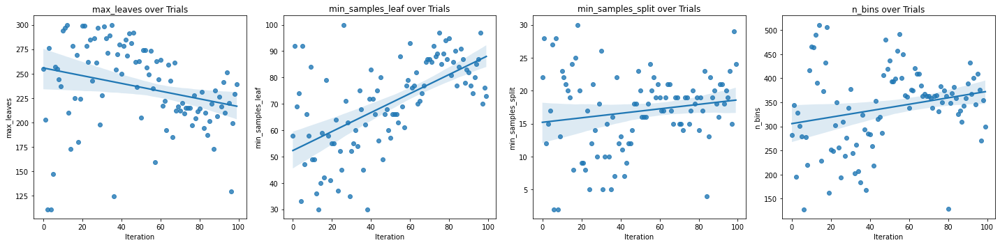

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
study = joblib.load('rfRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_precision.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 134, 'max_depth': 17, 'max_leaves': 212, 'min_samples_leaf': 86, 'min_samples_split': 19, 'n_bins': 367}
Highest Precision score 0.9991865178424917
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 134,
 'max_depth': 17,
 'max_leaves': 212,
 'min_samples_leaf': 86,
 'min_samples_split': 19,
 'n_bins': 367,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_100trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_100trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 100 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.71      0.83     54625

    accuracy                           0.96    432473
   macro avg       0.97      0.86      0.90    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[377436    412]
 [ 15713  38912]]


Accuracy score : 0.963
Precision score : 0.990
Recall score : 0.712
F1 score : 0.828


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.85563 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    68
precision                              0.999187
datetime_start       2022-09-21 19:54:33.858279
datetime_complete    2022-09-21 19:54:53.784053
duration                 0 days 00:00:19.925774
max_depth                                    17
max_leaves                                  212
min_samples_leaf                             86
min_samples_split                            19
n_bins                                      367
n_estimators                                134
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1099 ± 0.0002,recoveries
0.0441 ± 0.0003,out_prncp
0.0102 ± 0.0002,total_pymnt
0.0061 ± 0.0000,last_pymnt_amnt
0.0051 ± 0.0001,term_ 60 months
0.0013 ± 0.0001,total_rec_late_fee
0.0010 ± 0.0001,loan_amnt
0.0004 ± 0.0001,installment
0.0003 ± 0.0000,total_rec_int
0.0003 ± 0.0001,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,recoveries,0.109858,0.000111
1,out_prncp,0.044080,0.000140
2,total_pymnt,0.010178,0.000103
3,last_pymnt_amnt,0.006058,0.000024
4,term_ 60 months,0.005057,0.000032
5,total_rec_late_fee,0.001301,0.000039
6,loan_amnt,0.001049,0.000073
7,installment,0.000425,0.000050
8,total_rec_int,0.000300,0.000015
9,inq_last_6mths,0.000267,0.000043


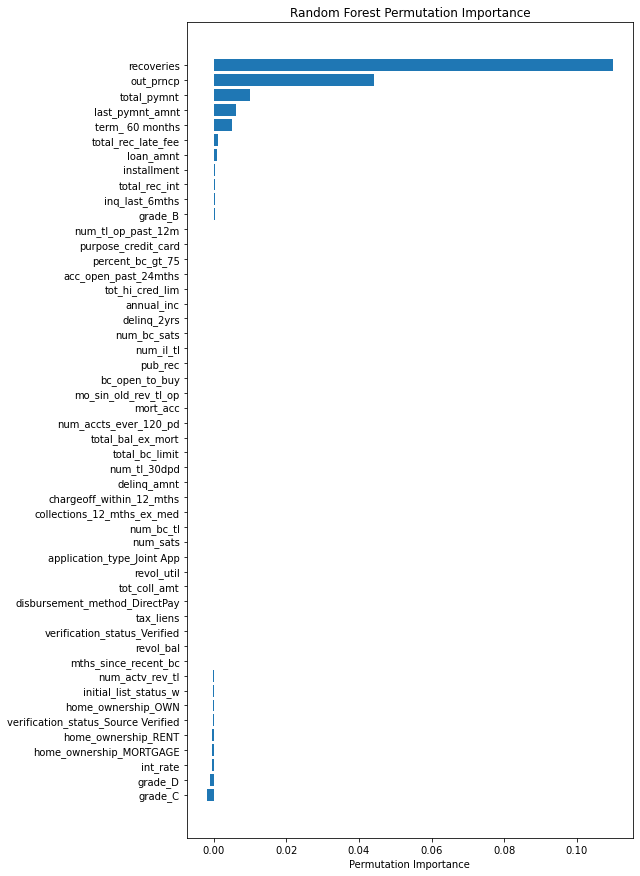

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_100_GPU_precision_permImportance.png', 
          dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_rfRapids_precision_300_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_rf300gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'smote_rf300gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 50, 200),
        'max_depth': trial.suggest_int('max_depth', 10, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 170, 350), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 5, 25),
        'n_bins': trial.suggest_int('n_bins', 200, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

- Trial time: 16.75966005306691
- Trial precision: 0.9983571890455968
######################################################
- Trial time: 23.49709227005951
- Trial precision: 0.9991177875646403
######################################################
- Trial time: 22.376828447915614
- Trial precision: 0.9994341935686669
######################################################
- Trial time: 29.252838424174115
- Trial precision: 0.9990099631176401
######################################################
- Trial time: 32.37411838909611
- Trial precision: 0.9991253867811446
######################################################
- Trial time: 29.748367740074173
- Trial precision: 0.9992604685559602
######################################################
- Trial time: 17.77198802214116
- Trial precision: 0.9992436968932323
######################################################
- Trial time: 11.52180322096683
- Trial precision: 0.9990538931772083
####################################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_precision.csv', index=False)
print(trials_df) 

     iteration  precision             datetime_start  \
135        135   0.999530 2022-09-23 16:58:14.654593   
182        182   0.999466 2022-09-23 17:17:35.202883   
100        100   0.999457 2022-09-23 16:44:43.360742   
147        147   0.999456 2022-09-23 17:03:45.487884   
79          79   0.999453 2022-09-23 16:37:21.830407   
..         ...        ...                        ...   
257        257   0.998720 2022-09-23 17:46:18.700869   
107        107   0.998585 2022-09-23 16:47:27.583526   
39          39   0.998488 2022-09-23 16:22:21.118484   
9            9   0.998363 2022-09-23 16:09:58.866658   
0            0   0.998357 2022-09-23 16:06:17.502141   

             datetime_complete               duration  max_depth  max_leaves  \
135 2022-09-23 16:58:41.149483 0 days 00:00:26.494890         27         350   
182 2022-09-23 17:17:57.866298 0 days 00:00:22.663415         21         337   
100 2022-09-23 16:45:07.729031 0 days 00:00:24.368289         28         337   
147 202

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

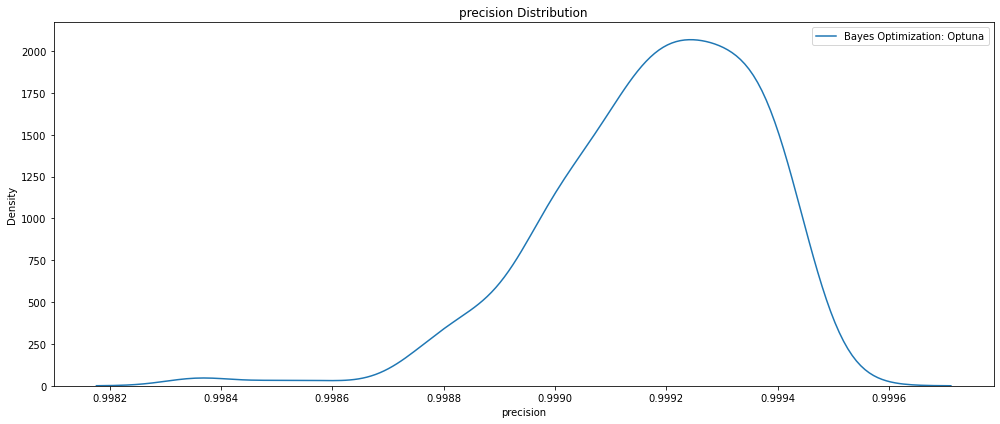

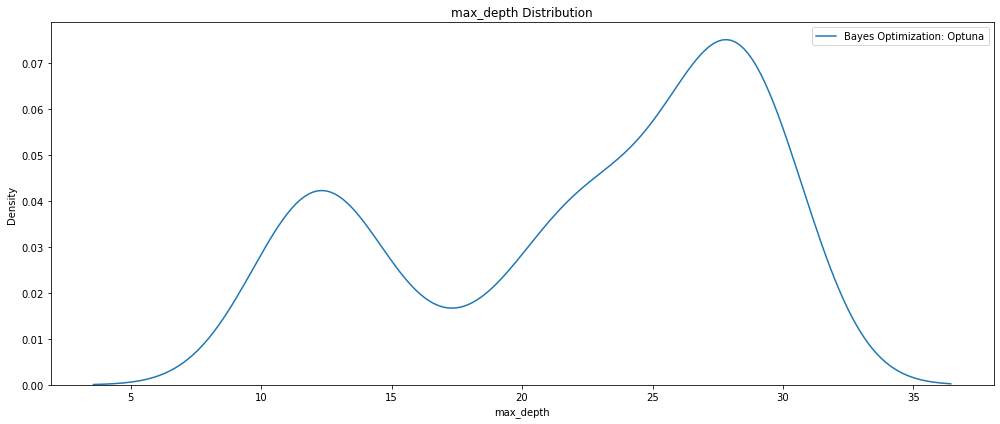

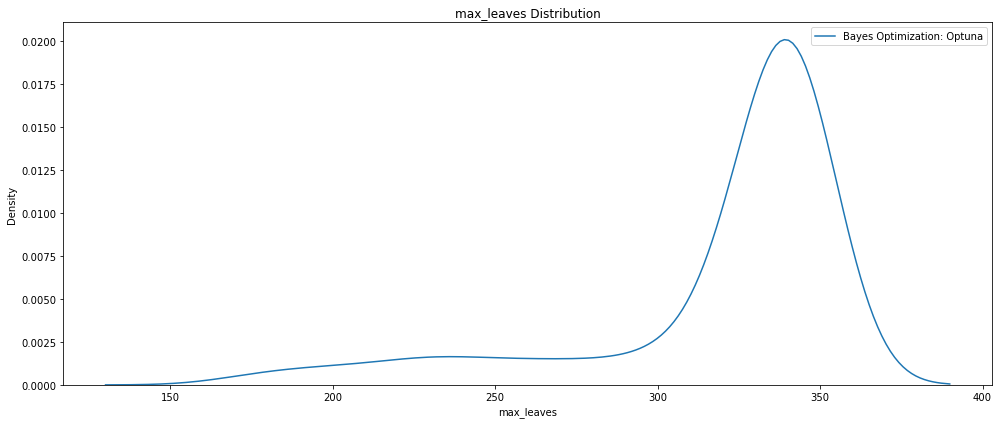

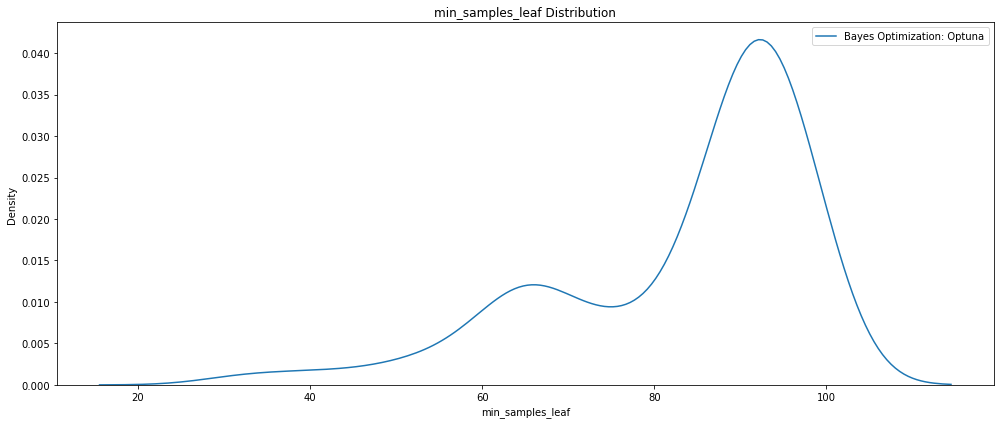

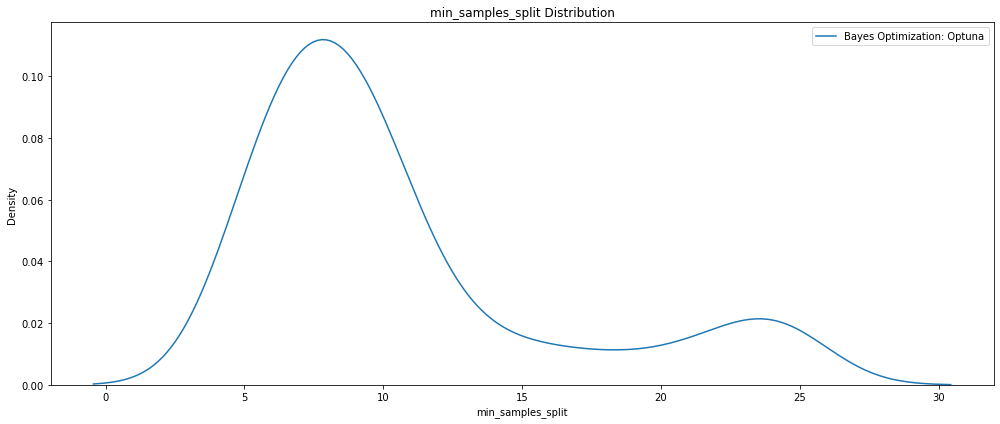

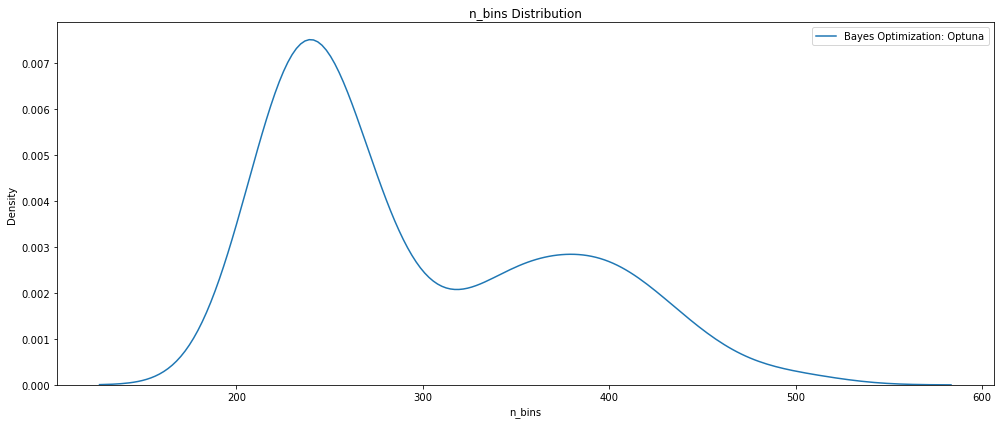

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

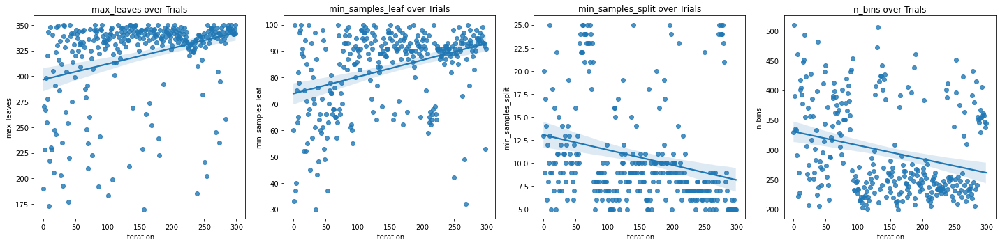

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value  
params

{'n_estimators': 135,
 'max_depth': 27,
 'max_leaves': 350,
 'min_samples_leaf': 89,
 'min_samples_split': 9,
 'n_bins': 424,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_SMOTE_300trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_SMOTE_100trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO SMOTE 300 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98    377848
           1       0.99      0.72      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.98      0.86      0.91    432473
weighted avg       0.97      0.96      0.96    432473



Confusion matrix:
[[377619    229]
 [ 15298  39327]]


Accuracy score : 0.964
Precision score : 0.994
Recall score : 0.720
F1 score : 0.835


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.85967 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   135
precision                               0.99953
datetime_start       2022-09-23 16:58:14.654593
datetime_complete    2022-09-23 16:58:41.149483
duration                 0 days 00:00:26.494890
max_depth                                    27
max_leaves                                  350
min_samples_leaf                             89
min_samples_split                             9
n_bins                                      424
n_estimators                                135
state                                  COMPLETE
Name: 135, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1087 ± 0.0002,recoveries
0.0545 ± 0.0002,out_prncp
0.0114 ± 0.0001,total_pymnt
0.0062 ± 0.0001,last_pymnt_amnt
0.0042 ± 0.0001,term_ 60 months
0.0011 ± 0.0000,total_rec_late_fee
0.0007 ± 0.0000,installment
0.0006 ± 0.0001,loan_amnt
0.0004 ± 0.0001,total_rec_int
0.0002 ± 0.0001,inq_last_6mths


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,recoveries,0.108734,0.000119
1,out_prncp,0.054478,0.000112
2,total_pymnt,0.011444,0.000070
3,last_pymnt_amnt,0.006152,0.000048
4,term_ 60 months,0.004223,0.000061
5,total_rec_late_fee,0.001149,0.000022
6,installment,0.000659,0.000014
7,loan_amnt,0.000624,0.000045
8,total_rec_int,0.000384,0.000031
9,inq_last_6mths,0.000223,0.000029


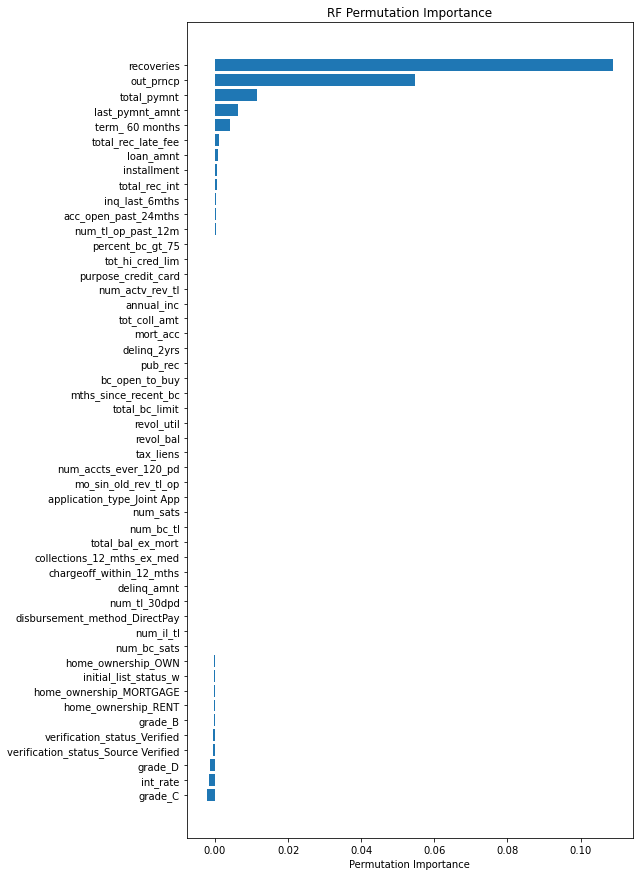

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('RF Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_SMOTE_300_GPU_precision_permImportance.png', 
          dpi=my_dpi, bbox_inches='tight');